In [1]:
import os
import sys
#sys.path.append('/home/cjw/Code/DeepLearning')

import tensorflow as tf
import numpy as np
import pandas as pd

from autoencoder import autoencoder_train
from autoencoder import network
from autoencoder import utils

/home/cjw/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
datadir = "/v/Data/cyto/mmCompensatedTifs/"
#datadir = "/media/cjw/Data/cyto/mmCompensatedTifs"

mmfiles = utils.list_mmfiles(datadir)
print(mmfiles)

mmdict = dict()

n_all_images = 0
for mmfilename in mmfiles:
#mmfilename = datadir + "Fish6_15_cjw_mean_zero.mm"
#mmfilename = datadir + "mmplate15-1.mm"
    mmheader = np.memmap(mmfilename, dtype="int32", mode='r',
                    shape=(4,))

    header_shape = mmheader.shape
    print(header_shape, mmheader)
    xshape = [mmheader[0], mmheader[1], mmheader[2], mmheader[3]]
    xshape = tuple(xshape)
    del mmheader
    n_all_images += xshape[0]
    
    m3 = np.memmap(mmfilename, dtype='float32', offset=128,
              mode='r', shape=xshape)
    key = mmfilename.split("/")[-1]
    mmdict[key] = m3

print(n_all_images)
mmdict.keys()

['/v/Data/cyto/mmCompensatedTifs/Fish4_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish3_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish4_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish1_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish2_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish2_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish5_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish1_Ice.mm', '/v/Data/cyto/mmCompensatedTifs/Fish6_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish3_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish4_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish6_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish3_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish6_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish2_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish5_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish1_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish5_ICE.mm']
(4,) [10000    64    64     5]
(4,) [10000    64    64     5]
(4,) [10000    64    64     5]
(4,) [10000    64    64 

dict_keys(['Fish4_Untreated.mm', 'Fish3_CCB.mm', 'Fish4_CCB.mm', 'Fish1_Untreated.mm', 'Fish2_ICE.mm', 'Fish2_CCB.mm', 'Fish5_CCB.mm', 'Fish1_Ice.mm', 'Fish6_CCB.mm', 'Fish3_Untreated.mm', 'Fish4_ICE.mm', 'Fish6_ICE.mm', 'Fish3_ICE.mm', 'Fish6_Untreated.mm', 'Fish2_Untreated.mm', 'Fish5_Untreated.mm', 'Fish1_CCB.mm', 'Fish5_ICE.mm'])

In [3]:
n = xshape[0]
all_ids =  range(n_all_images)
idx = 0
dataframes = list()
for key in mmdict.keys():
    mm = mmdict[key]
    n = mm.shape[0]
    print(n)
    file = n*[key[0:-3]]
    fid = range(n)
    mmfile = n*[key]
    plate = n*[0]
    row = n*[0]
    column = n*[0]
    field = n*[0]
    yc = n*[32]
    xc = n*[32]
    well = n*[0]
    ids = all_ids[idx:idx + n]
    idx += n
    df = pd.DataFrame({'id':ids, 'fid':fid, 'file':file, 'mmfile':mmfile, 'plate':plate,
                     'row':row, 'column':column, 'field':field,
                      'yc':yc, 'xc':xc, 'well':well})

    dataframes.append(df)
    
p_df = pd.concat(dataframes, ignore_index=True)

10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000


Encoder True
Tensor("Placeholder:0", shape=(?, 32, 32, 4), dtype=float32) (?, 32, 32, 4)
isize:  4 32
dh0 (?, 32, 32, 4)
180000 1406 128
Epoch:  0 Iteration:  0 Loss:  897.284 605.687 291.597


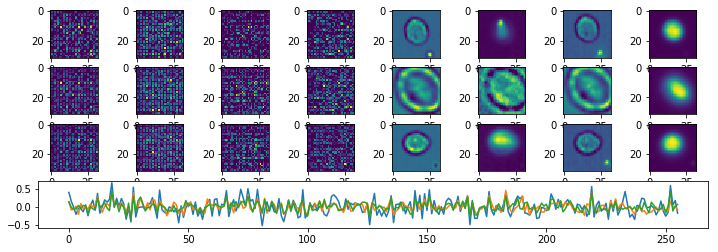

Epoch:  0 Iteration:  500 Loss:  13.724431 12.0972 1.6272303


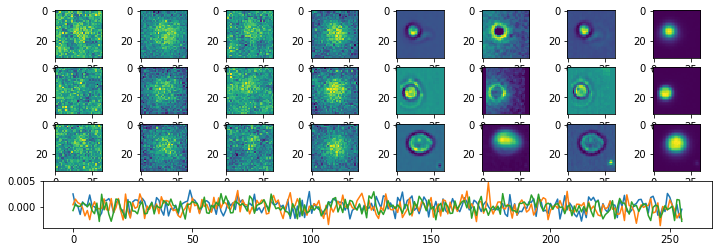

Epoch:  0 Iteration:  1000 Loss:  11.739812 10.803778 0.9360342


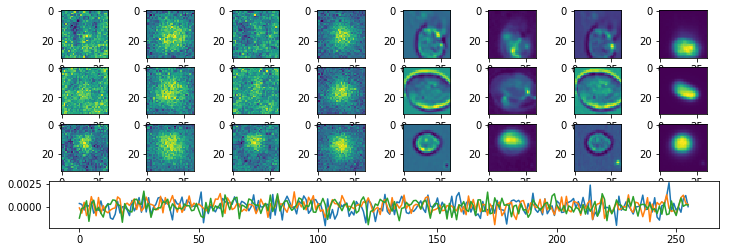

Epoch:  1 Iteration:  0 Loss:  10.929394 10.040659 0.888735


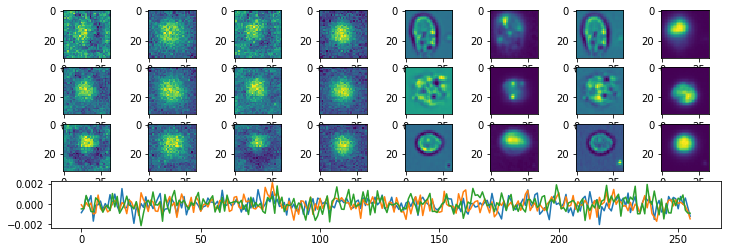

Epoch:  1 Iteration:  500 Loss:  12.362907 11.131189 1.2317182


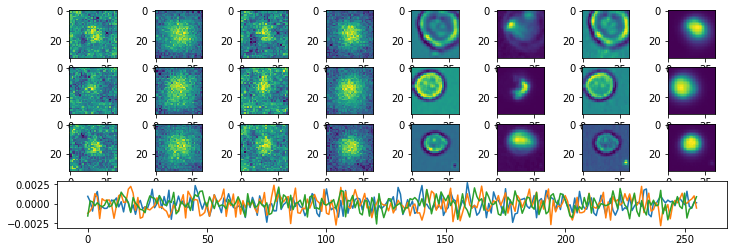

Epoch:  1 Iteration:  1000 Loss:  11.482694 10.55608 0.9266138


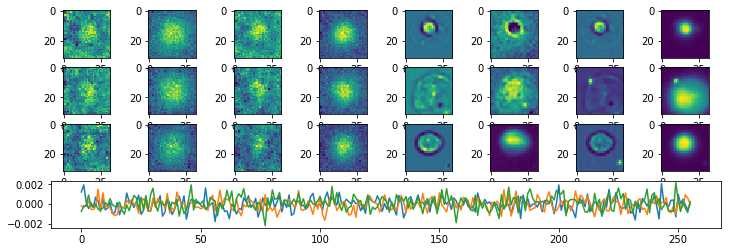

Epoch:  2 Iteration:  0 Loss:  11.290804 10.341748 0.9490552


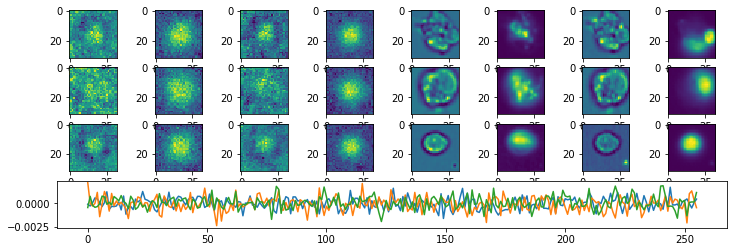

Epoch:  2 Iteration:  500 Loss:  10.963154 9.990465 0.9726891


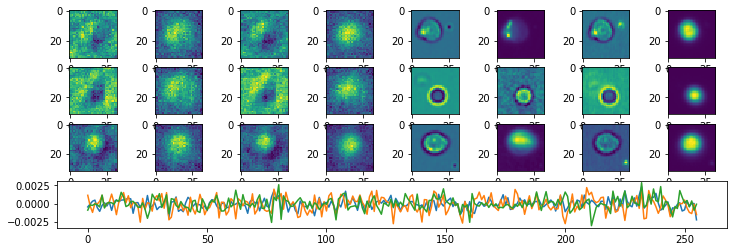

Epoch:  2 Iteration:  1000 Loss:  10.216276 9.335653 0.880623


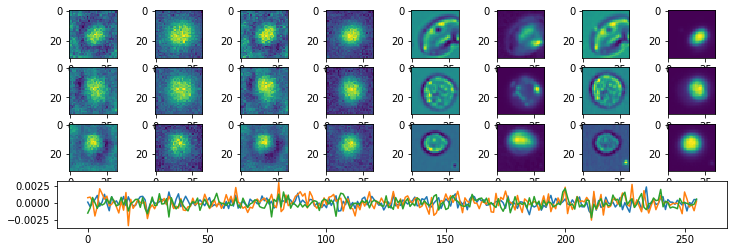

Epoch:  3 Iteration:  0 Loss:  10.148187 9.256412 0.89177513


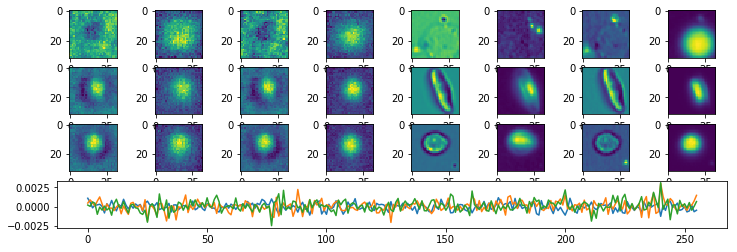

Epoch:  3 Iteration:  500 Loss:  9.851922 8.972157 0.8797655


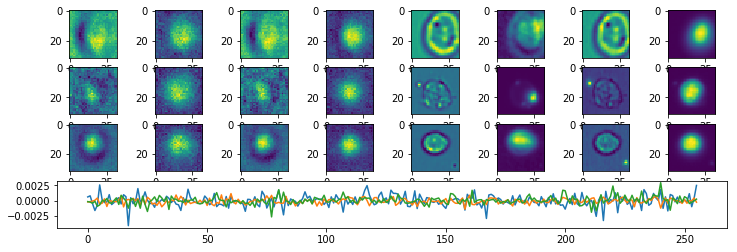

Epoch:  3 Iteration:  1000 Loss:  9.121581 8.198294 0.9232877


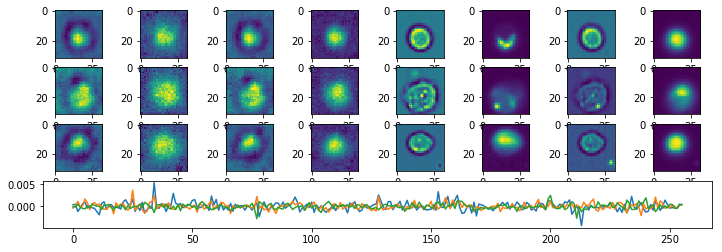

Epoch:  4 Iteration:  0 Loss:  8.597169 7.592612 1.0045575


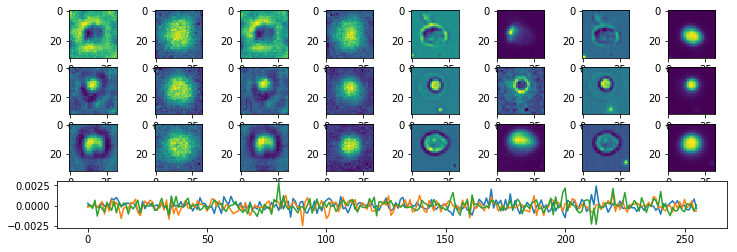

Epoch:  4 Iteration:  500 Loss:  8.105332 7.0499406 1.0553916


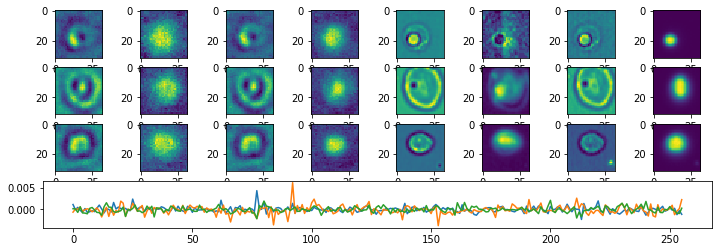

Epoch:  4 Iteration:  1000 Loss:  11.575556 8.612352 2.9632032


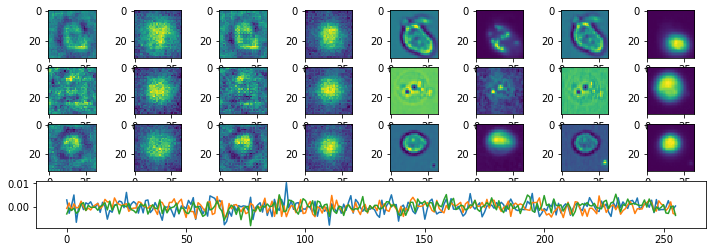

Epoch:  5 Iteration:  0 Loss:  9.040709 6.942134 2.0985744


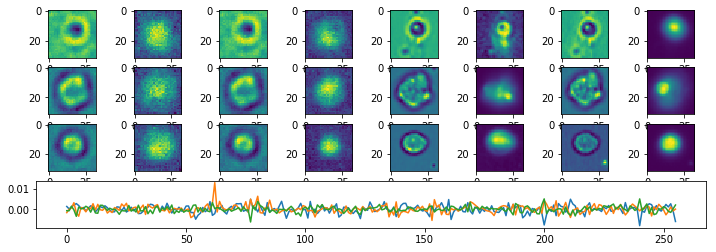

Epoch:  5 Iteration:  500 Loss:  8.347509 6.652158 1.6953515


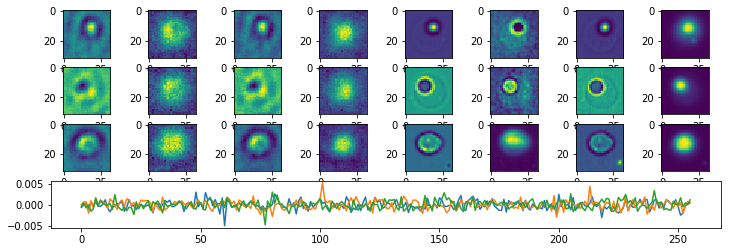

Epoch:  5 Iteration:  1000 Loss:  7.6165533 6.212245 1.4043082


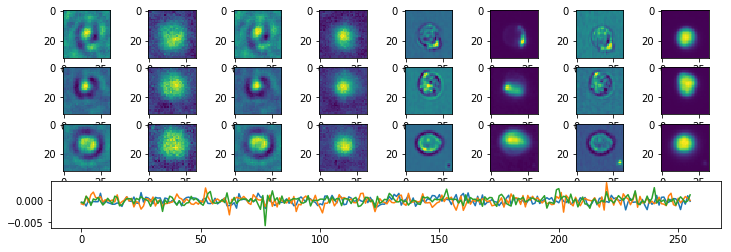

Epoch:  6 Iteration:  0 Loss:  7.1796722 5.8802032 1.2994688


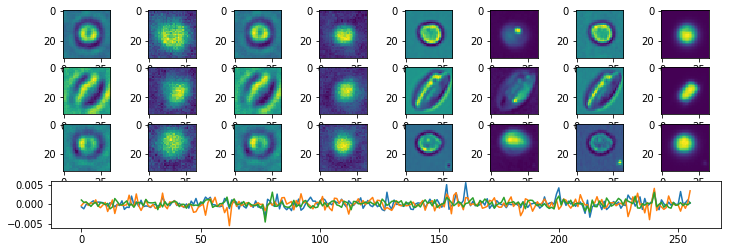

Epoch:  6 Iteration:  500 Loss:  7.241103 5.997919 1.243184


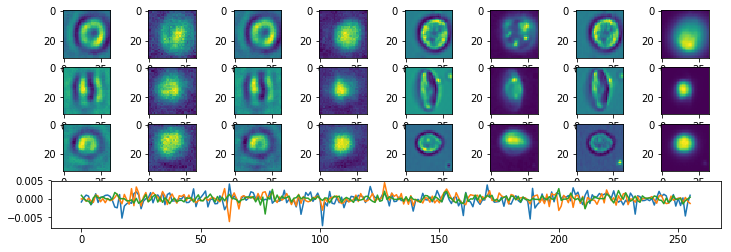

Epoch:  6 Iteration:  1000 Loss:  6.8658104 5.7571964 1.1086141


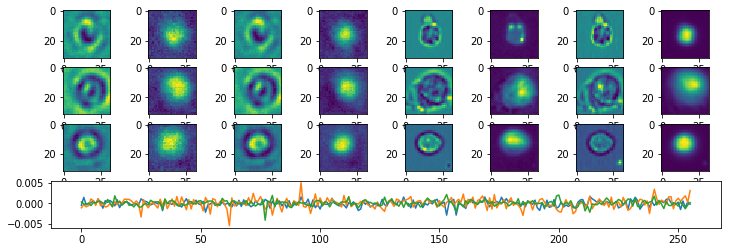

Epoch:  7 Iteration:  0 Loss:  68.63277 30.250069 38.3827


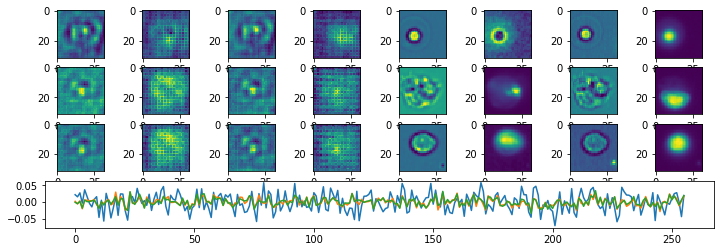

Epoch:  7 Iteration:  500 Loss:  6.7372837 5.4951696 1.2421143


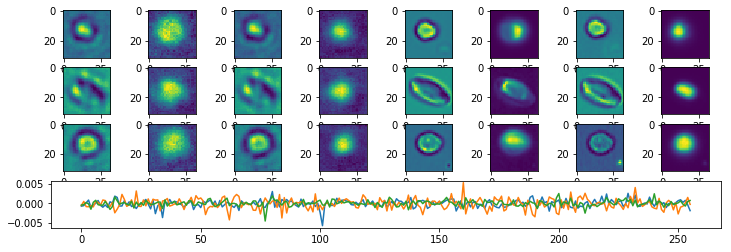

Epoch:  7 Iteration:  1000 Loss:  6.224283 5.1692176 1.0550658


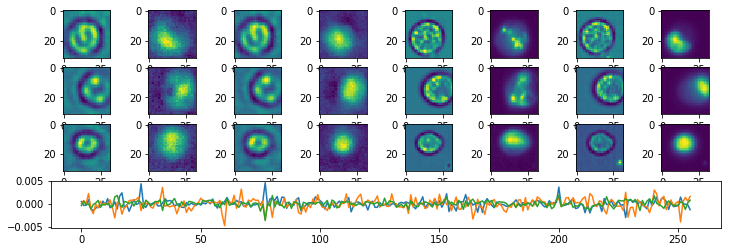

Epoch:  8 Iteration:  0 Loss:  5.9804974 4.9139566 1.066541


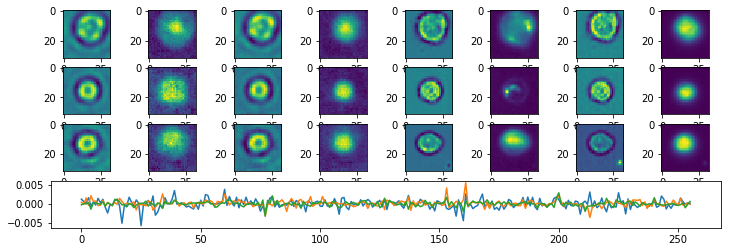

Epoch:  8 Iteration:  500 Loss:  9.504424 7.118215 2.3862092


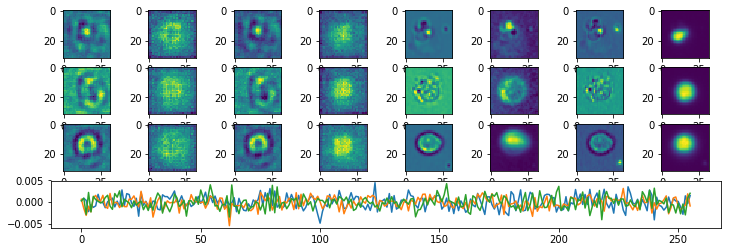

Epoch:  8 Iteration:  1000 Loss:  6.9155116 5.4415197 1.473992


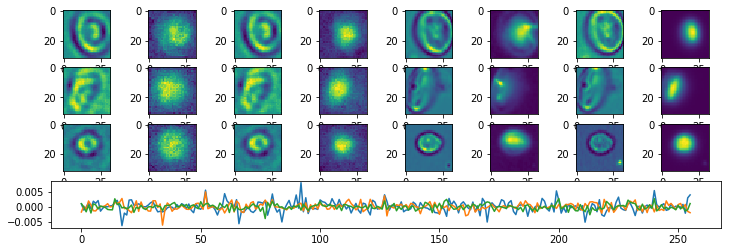

Epoch:  9 Iteration:  0 Loss:  6.5178323 5.142604 1.3752283


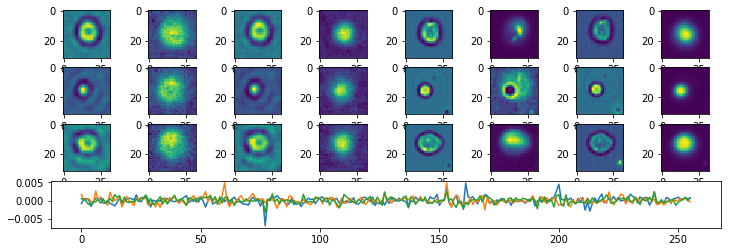

Epoch:  9 Iteration:  500 Loss:  6.381866 5.2052503 1.1766156


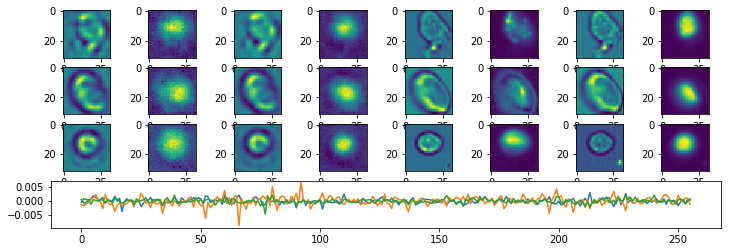

Epoch:  9 Iteration:  1000 Loss:  5.8930464 4.844346 1.0487006


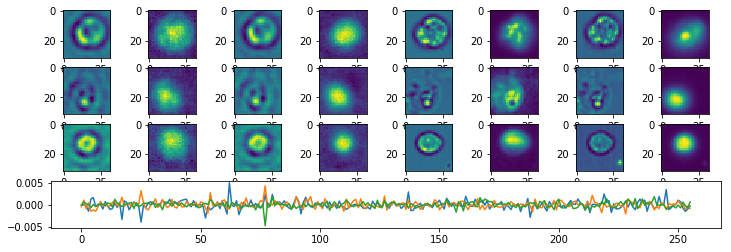

Epoch:  10 Iteration:  0 Loss:  5.642178 4.6193457 1.0228325


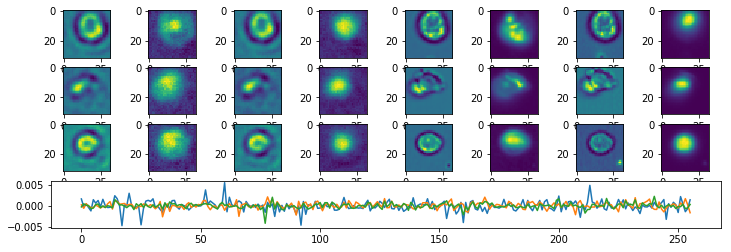

Epoch:  10 Iteration:  500 Loss:  5.987089 4.980461 1.0066283


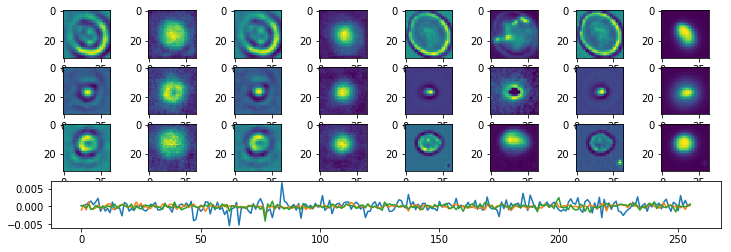

Epoch:  10 Iteration:  1000 Loss:  5.5555215 4.5770974 0.9784241


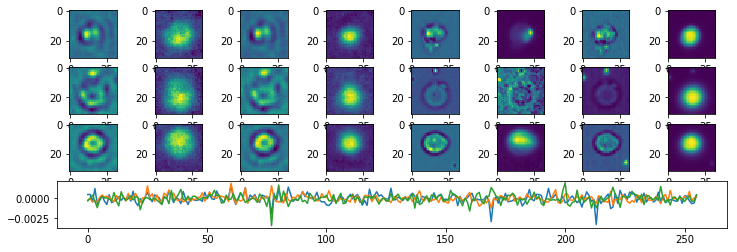

Epoch:  11 Iteration:  0 Loss:  8.409066 5.850671 2.5583951


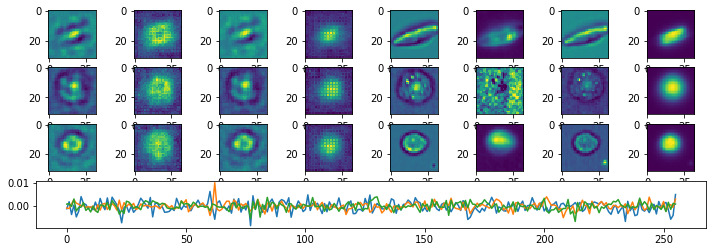

Epoch:  11 Iteration:  500 Loss:  6.307094 4.718775 1.5883192


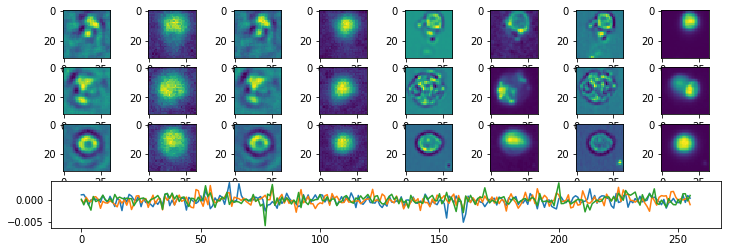

Epoch:  11 Iteration:  1000 Loss:  5.769148 4.5057573 1.2633905


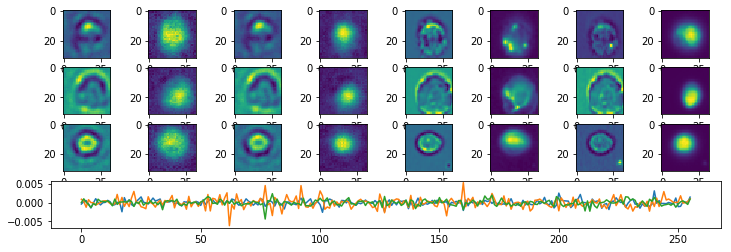

Epoch:  12 Iteration:  0 Loss:  5.6254773 4.4201627 1.2053145


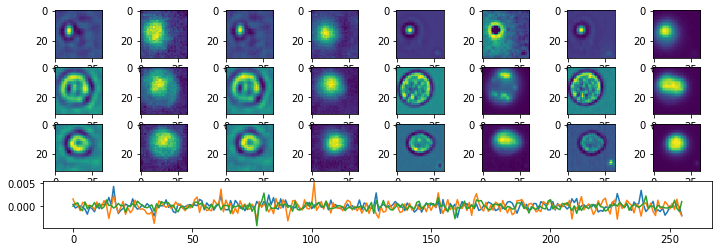

Epoch:  12 Iteration:  500 Loss:  5.4463778 4.3731866 1.073191


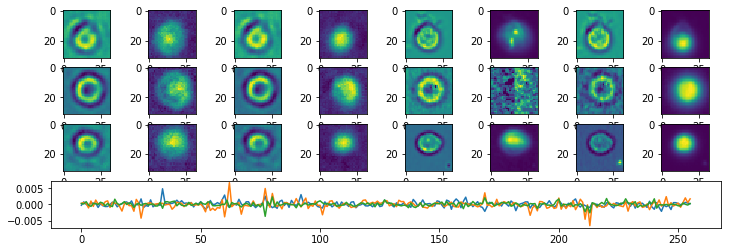

Epoch:  12 Iteration:  1000 Loss:  5.3090158 4.2901373 1.0188783


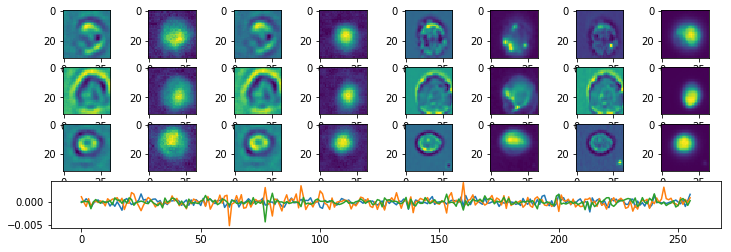

Epoch:  13 Iteration:  0 Loss:  5.0354857 4.1036634 0.93182224


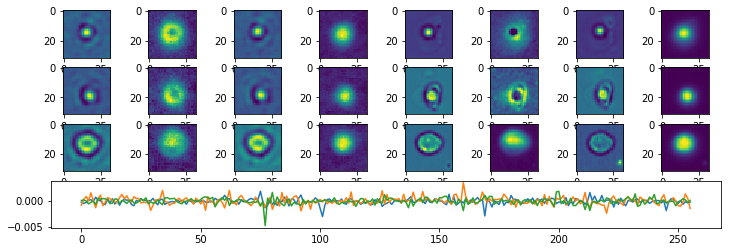

Epoch:  13 Iteration:  500 Loss:  8.052746 5.4380603 2.614686


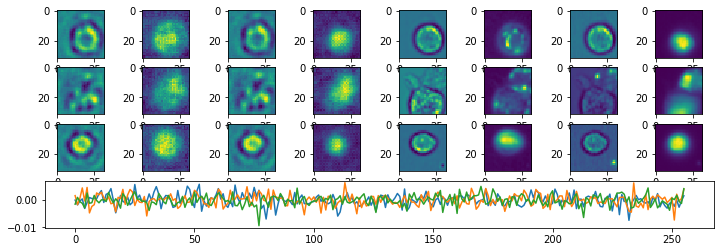

Epoch:  13 Iteration:  1000 Loss:  6.535741 4.655773 1.8799676


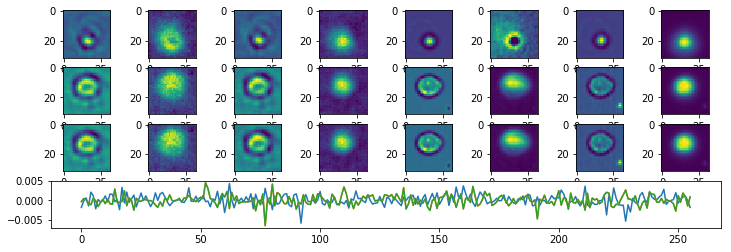

Epoch:  14 Iteration:  0 Loss:  5.9841695 4.369597 1.6145725


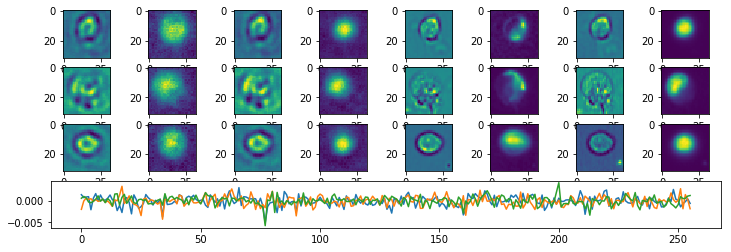

Epoch:  14 Iteration:  500 Loss:  5.7307377 4.3352876 1.3954502


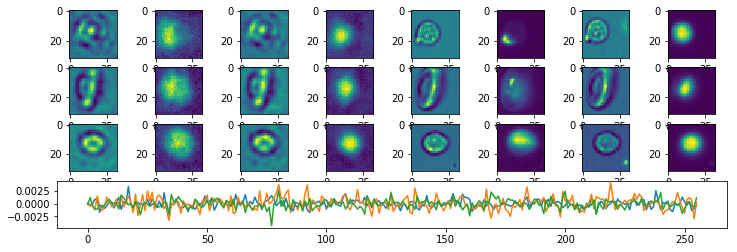

Epoch:  14 Iteration:  1000 Loss:  5.4438343 4.237123 1.2067115


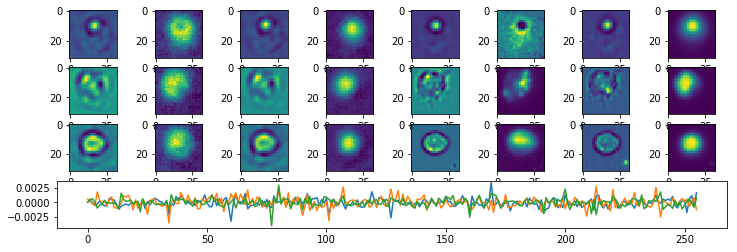

Epoch:  15 Iteration:  0 Loss:  5.2294292 4.085664 1.1437653


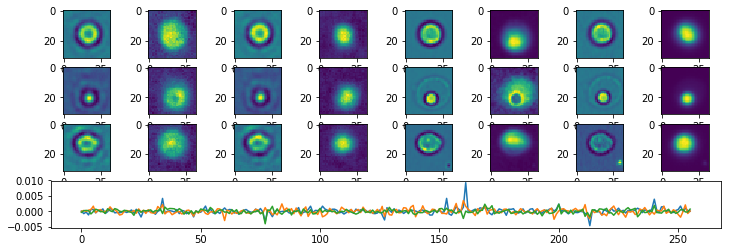

Epoch:  15 Iteration:  500 Loss:  5.1654477 4.1007085 1.0647391


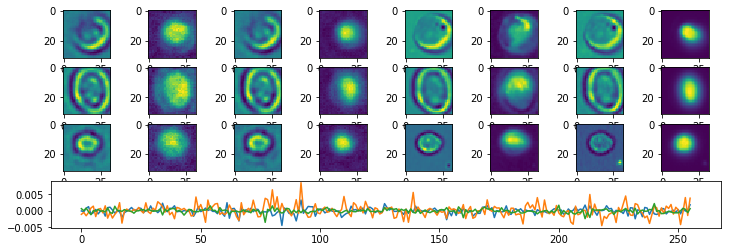

Epoch:  15 Iteration:  1000 Loss:  5.1570263 4.0240183 1.1330081


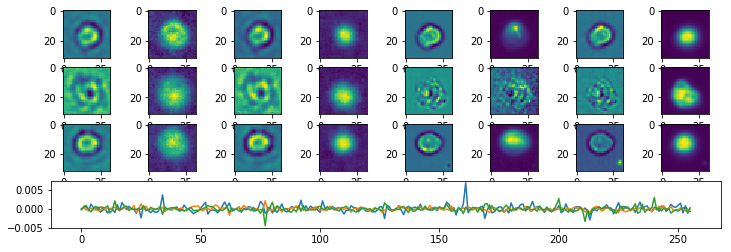

Epoch:  16 Iteration:  0 Loss:  4.967098 3.9852562 0.9818422


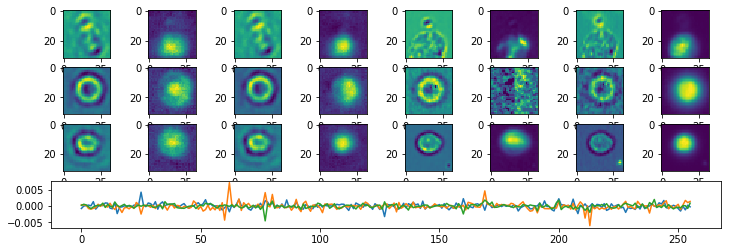

Epoch:  16 Iteration:  500 Loss:  4.915635 3.9812992 0.9343362


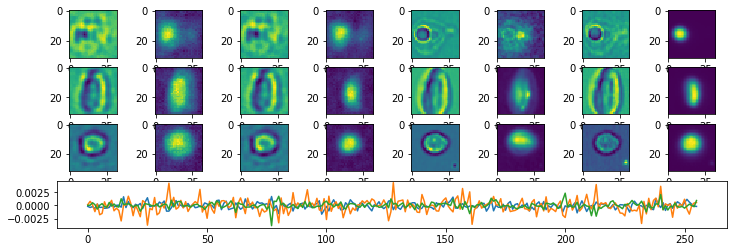

Epoch:  16 Iteration:  1000 Loss:  4.64115 3.7527394 0.8884104


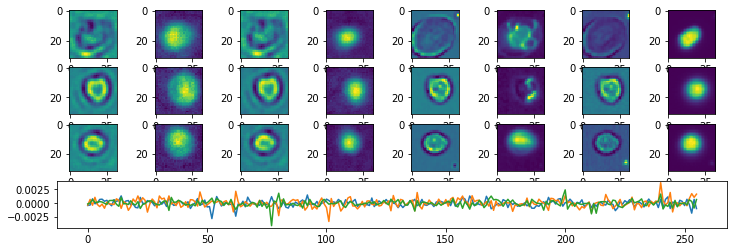

Epoch:  17 Iteration:  0 Loss:  7.2630234 4.9406147 2.3224084


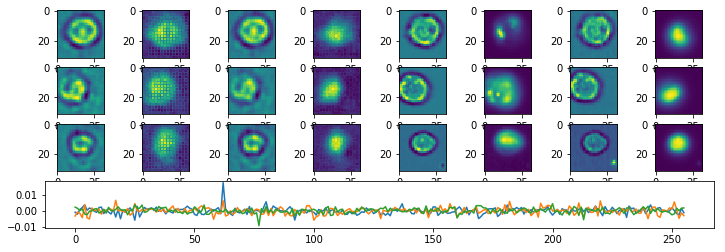

Epoch:  17 Iteration:  500 Loss:  5.701874 4.189459 1.5124148


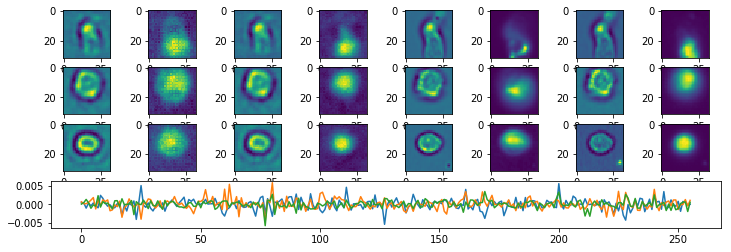

Epoch:  17 Iteration:  1000 Loss:  5.091982 3.8660138 1.2259684


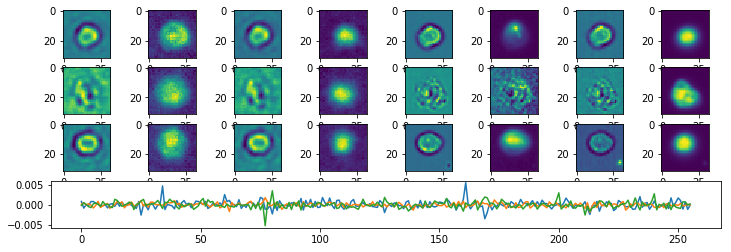

Epoch:  18 Iteration:  0 Loss:  4.8217154 3.6917503 1.1299648


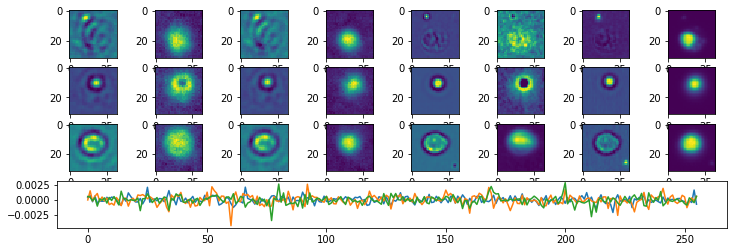

Epoch:  18 Iteration:  500 Loss:  4.881613 3.834089 1.0475239


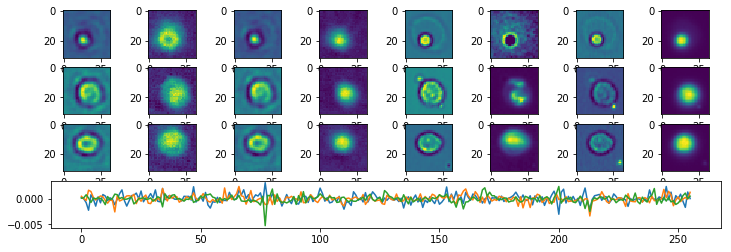

Epoch:  18 Iteration:  1000 Loss:  4.726823 3.7643676 0.9624553


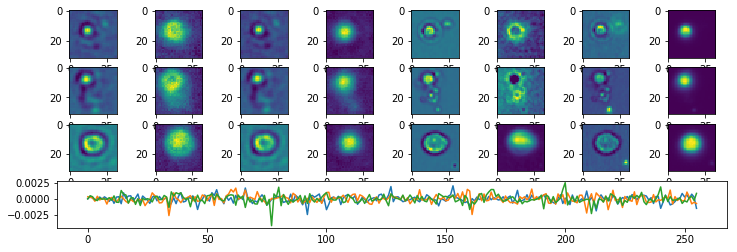

Epoch:  19 Iteration:  0 Loss:  4.534245 3.5935216 0.94072324


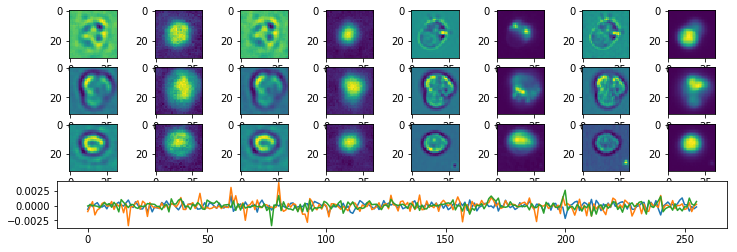

Epoch:  19 Iteration:  500 Loss:  4.452697 3.5580797 0.8946169


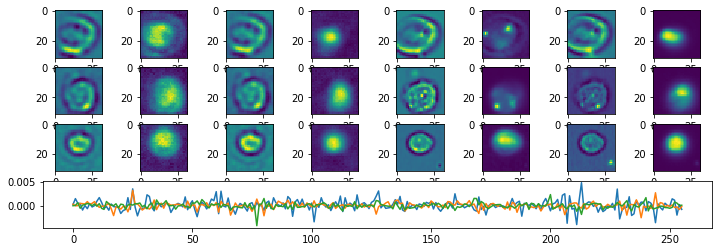

Epoch:  19 Iteration:  1000 Loss:  4.338436 3.4980834 0.84035265


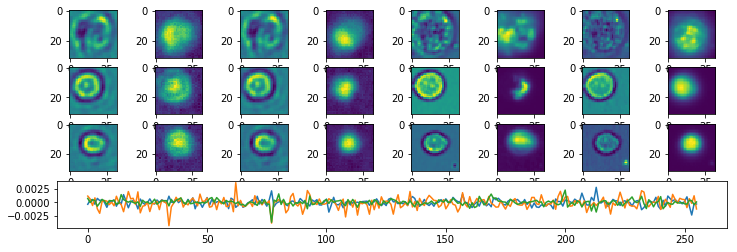

Epoch:  20 Iteration:  0 Loss:  5.972028 4.179758 1.7922697


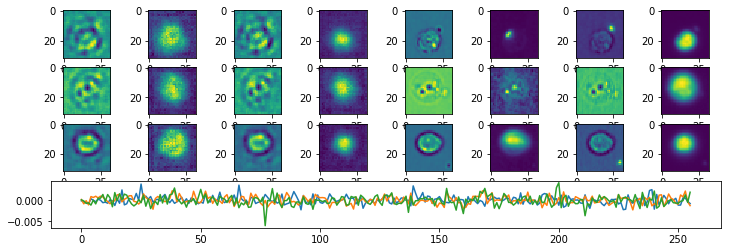

Epoch:  20 Iteration:  500 Loss:  5.1428013 3.8178465 1.3249546


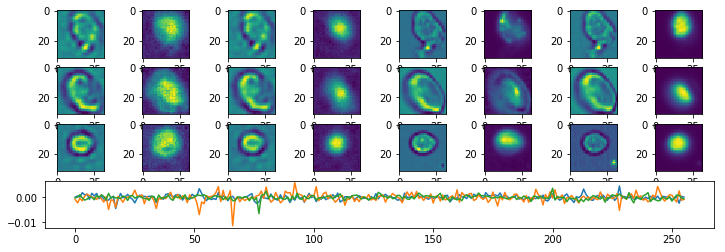

Epoch:  20 Iteration:  1000 Loss:  4.8139353 3.6855001 1.1284351


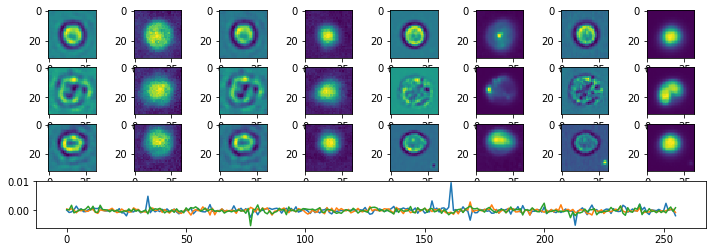

Epoch:  21 Iteration:  0 Loss:  4.5456934 3.4835896 1.062104


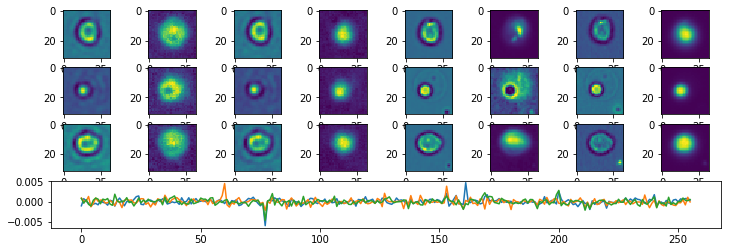

Epoch:  21 Iteration:  500 Loss:  4.642757 3.62898 1.0137771


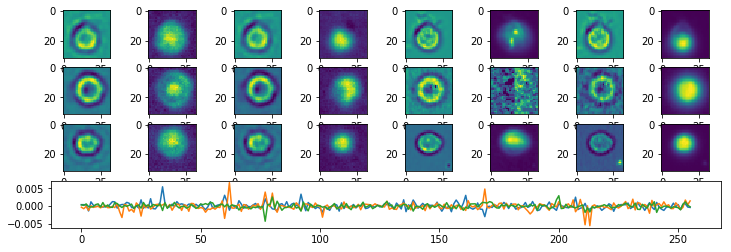

Epoch:  21 Iteration:  1000 Loss:  4.4349184 3.4705434 0.96437514


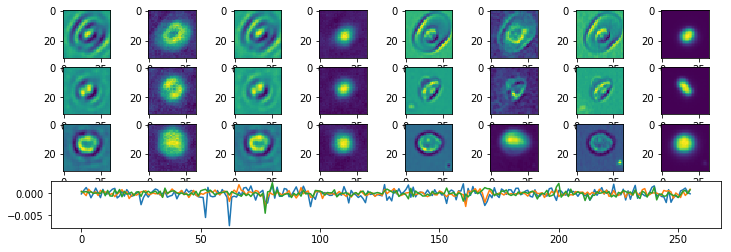

Epoch:  22 Iteration:  0 Loss:  4.2061343 3.3079314 0.8982027


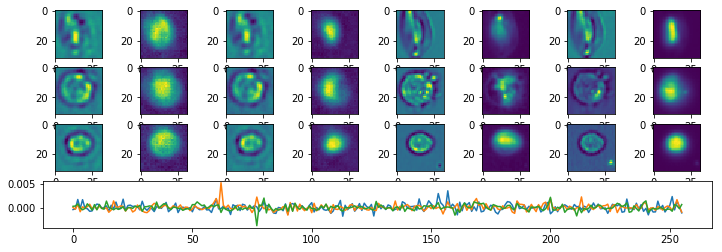

Epoch:  22 Iteration:  500 Loss:  4.3880205 3.4538288 0.9341915


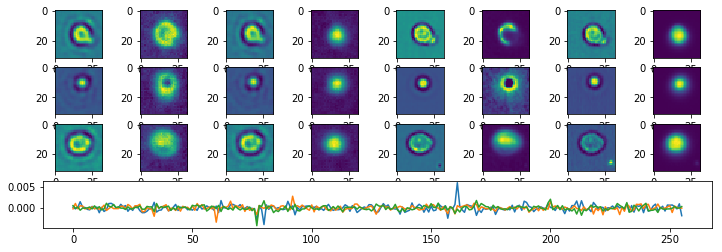

Epoch:  22 Iteration:  1000 Loss:  6.720022 4.6967497 2.0232723


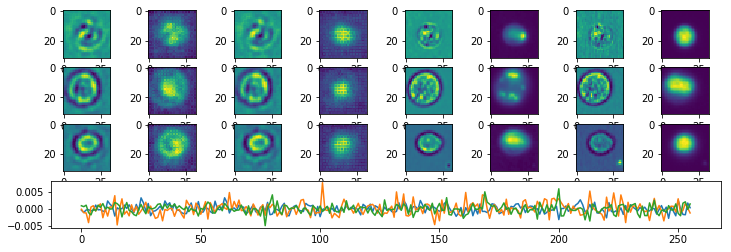

Epoch:  23 Iteration:  0 Loss:  5.0679116 3.6352386 1.4326729


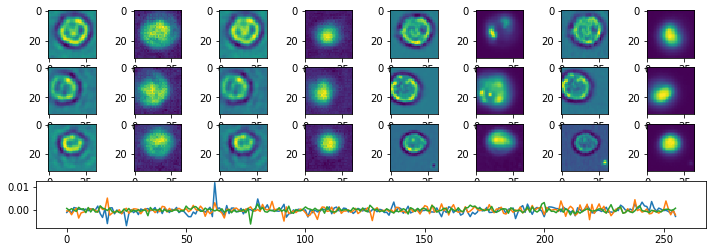

Epoch:  23 Iteration:  500 Loss:  4.8098297 3.5799794 1.2298504


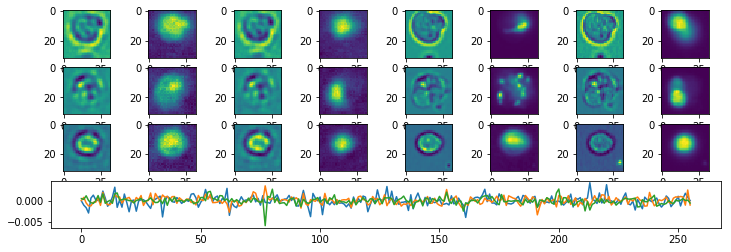

Epoch:  23 Iteration:  1000 Loss:  4.4792557 3.410736 1.0685195


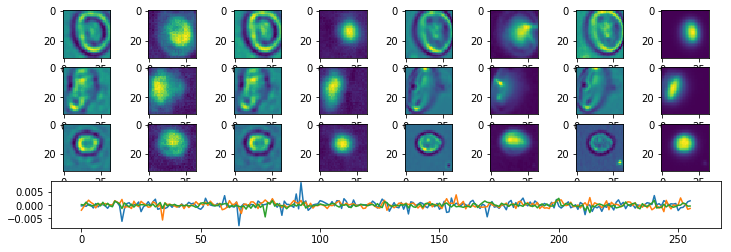

Epoch:  24 Iteration:  0 Loss:  4.315734 3.2683659 1.0473683


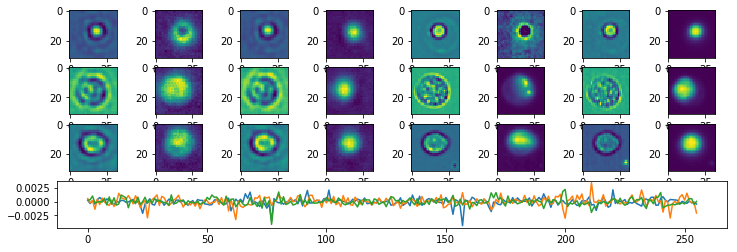

Epoch:  24 Iteration:  500 Loss:  4.3451886 3.3513632 0.9938254


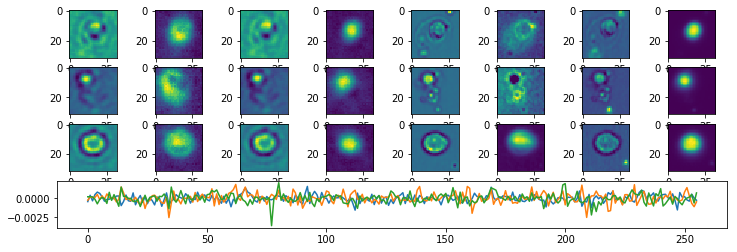

Epoch:  24 Iteration:  1000 Loss:  4.2175336 3.3069868 0.9105469


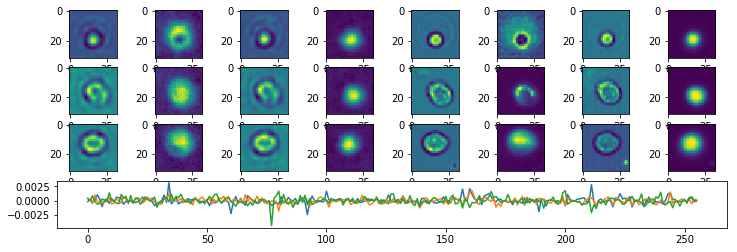

Epoch:  25 Iteration:  0 Loss:  4.040793 3.1662087 0.8745844


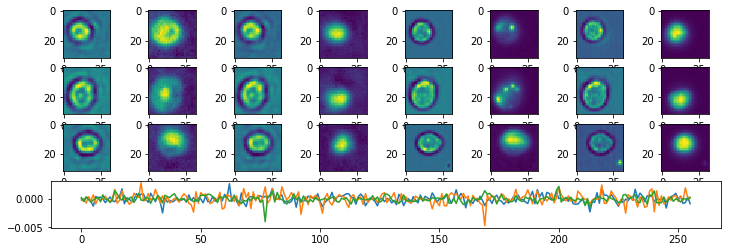

Epoch:  25 Iteration:  500 Loss:  4.201084 3.3290076 0.8720767


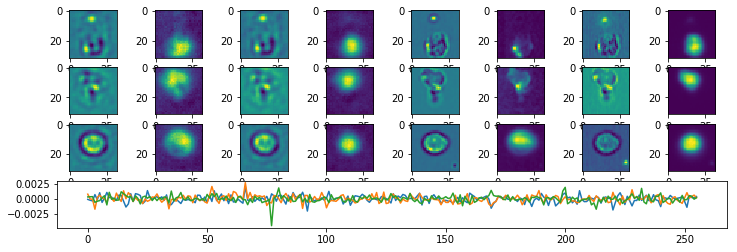

Epoch:  25 Iteration:  1000 Loss:  5.5433383 3.8323863 1.710952


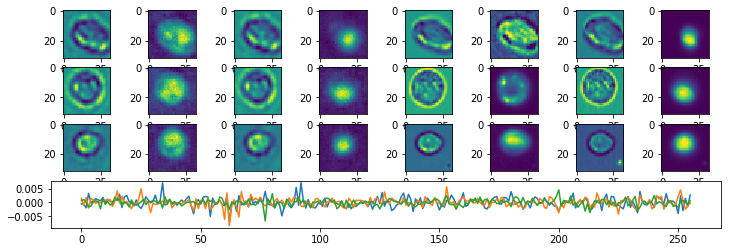

Epoch:  26 Iteration:  0 Loss:  4.538433 3.303359 1.2350743


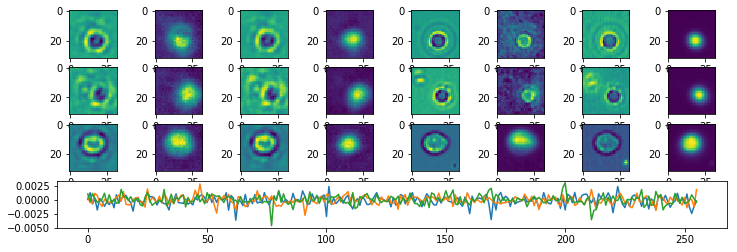

Epoch:  26 Iteration:  500 Loss:  4.4326353 3.3484664 1.0841688


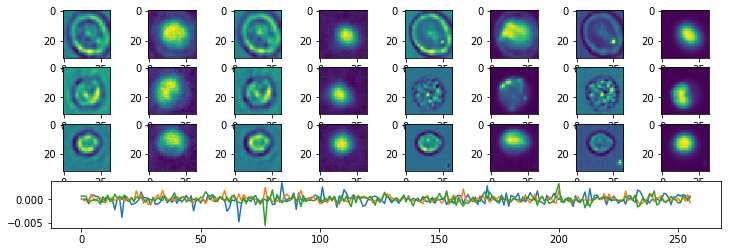

Epoch:  26 Iteration:  1000 Loss:  4.175998 3.2243176 0.9516806


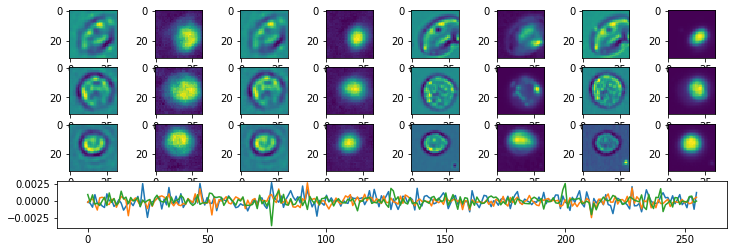

Epoch:  27 Iteration:  0 Loss:  3.972266 3.0734258 0.89884025


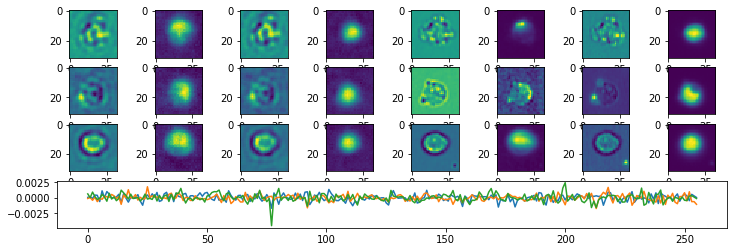

Epoch:  27 Iteration:  500 Loss:  4.1444387 3.2456093 0.89882964


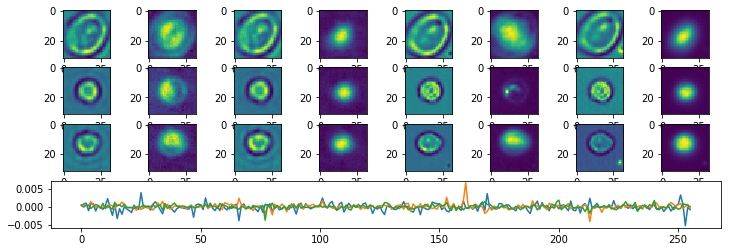

Epoch:  27 Iteration:  1000 Loss:  3.856381 3.0196548 0.8367261


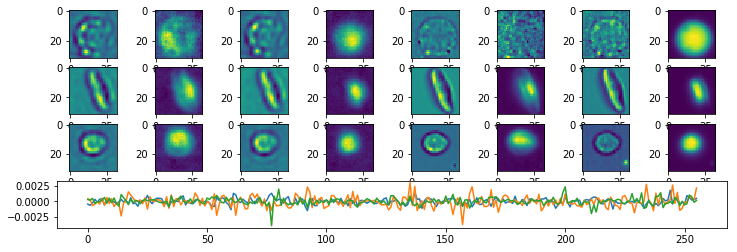

Epoch:  28 Iteration:  0 Loss:  3.930788 3.1130078 0.81778014


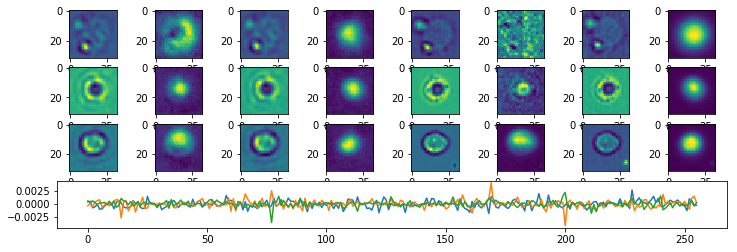

Epoch:  28 Iteration:  500 Loss:  7.030904 4.532854 2.4980497


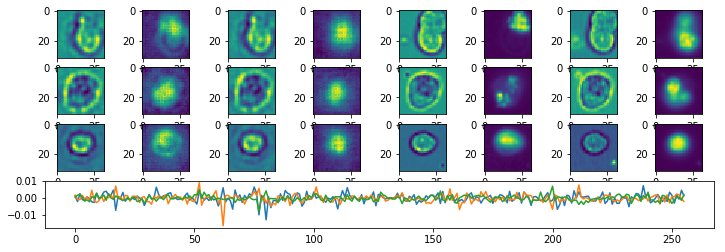

Epoch:  28 Iteration:  1000 Loss:  4.6637974 3.3258471 1.3379503


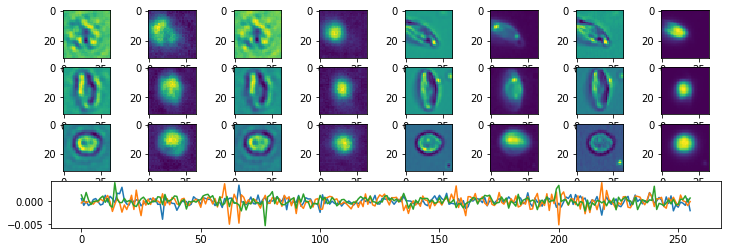

Epoch:  29 Iteration:  0 Loss:  4.1605415 3.0016818 1.1588596


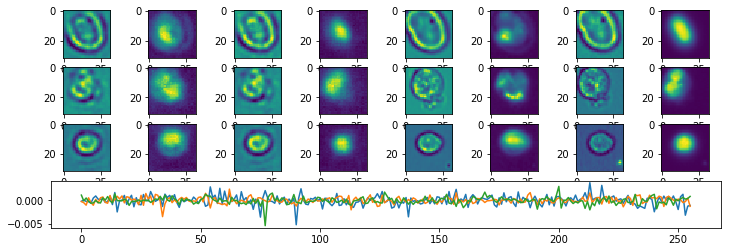

Epoch:  29 Iteration:  500 Loss:  4.0668745 3.058435 1.0084394


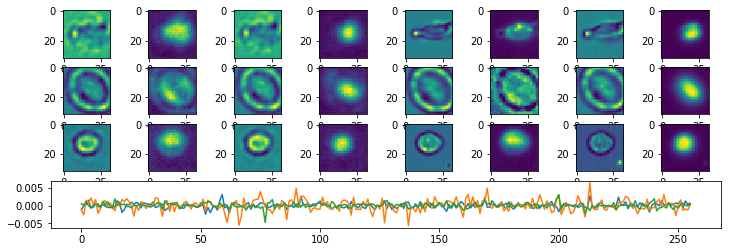

Epoch:  29 Iteration:  1000 Loss:  3.965436 3.0252824 0.9401537


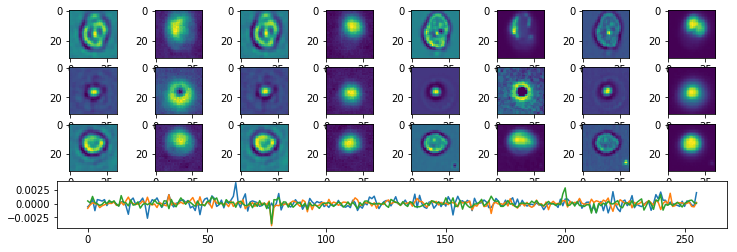

Epoch:  30 Iteration:  0 Loss:  3.7671695 2.8694062 0.89776325


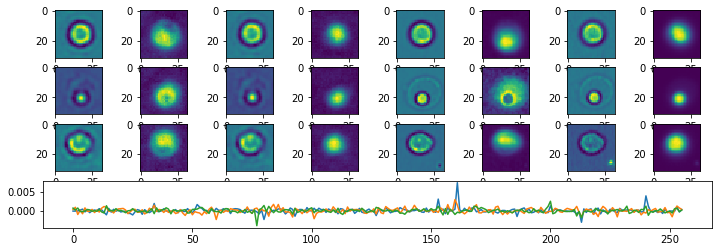

Epoch:  30 Iteration:  500 Loss:  4.225192 3.1698205 1.0553714


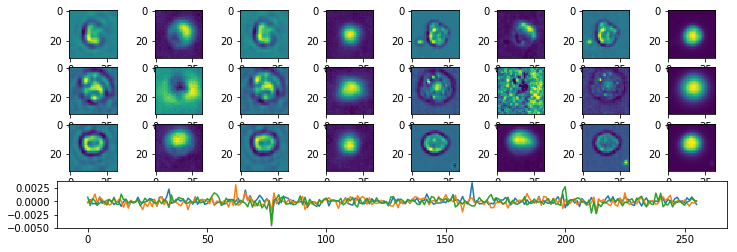

Epoch:  30 Iteration:  1000 Loss:  3.7606714 2.9266746 0.8339968


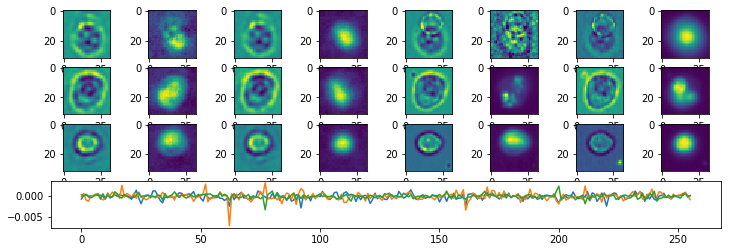

Epoch:  31 Iteration:  0 Loss:  3.6117387 2.8076458 0.804093


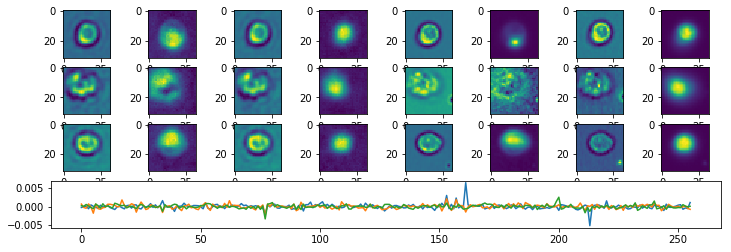

Epoch:  31 Iteration:  500 Loss:  4.243021 3.1742558 1.068765


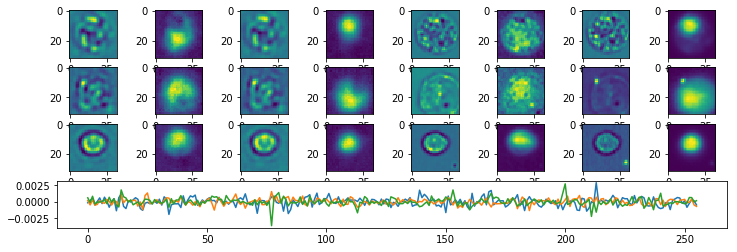

Epoch:  31 Iteration:  1000 Loss:  3.6392317 2.8409956 0.7982361


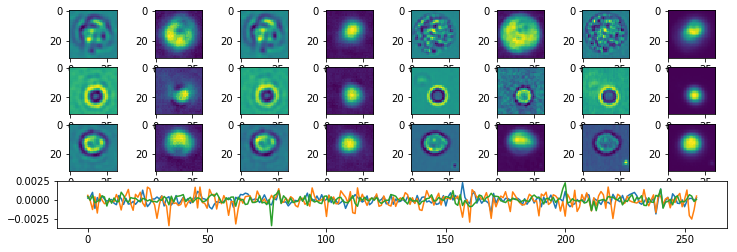

Epoch:  32 Iteration:  0 Loss:  3.4546714 2.682533 0.77213824


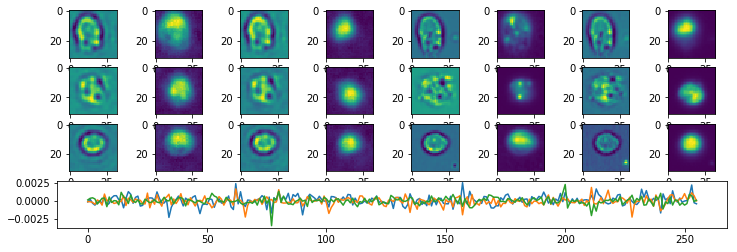

Epoch:  32 Iteration:  500 Loss:  7.460584 5.0553427 2.4052415


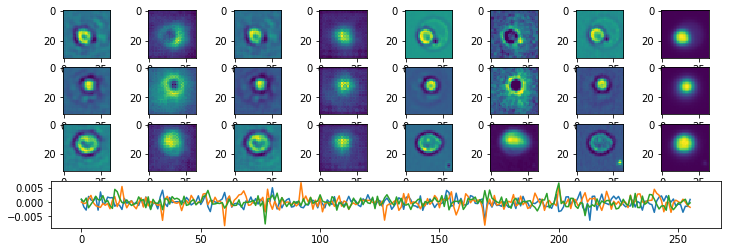

Epoch:  32 Iteration:  1000 Loss:  4.325037 3.068341 1.2566961


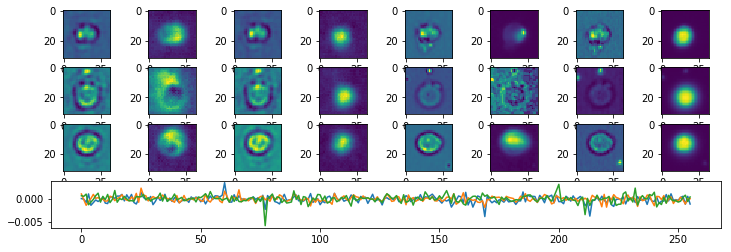

Epoch:  33 Iteration:  0 Loss:  3.9305658 2.844376 1.0861896


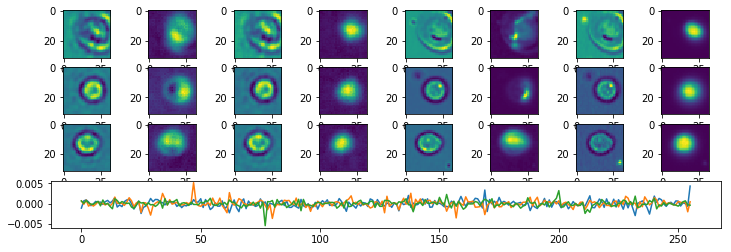

Epoch:  33 Iteration:  500 Loss:  3.9377403 2.9280684 1.0096718


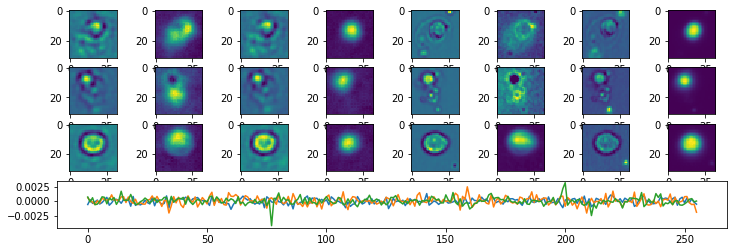

Epoch:  33 Iteration:  1000 Loss:  3.7907708 2.862235 0.92853564


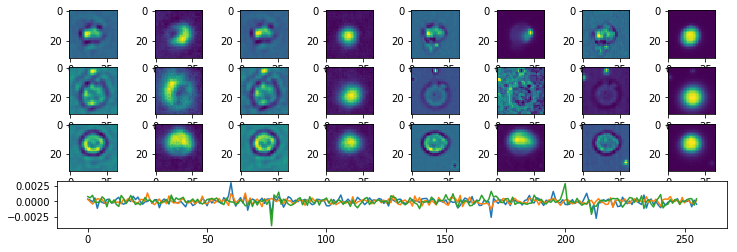

Epoch:  34 Iteration:  0 Loss:  3.536 2.6566114 0.8793885


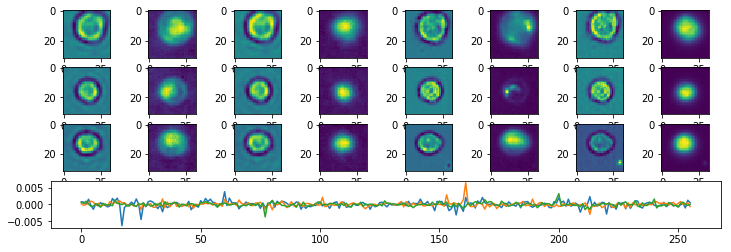

Epoch:  34 Iteration:  500 Loss:  3.7068155 2.8566592 0.85015625


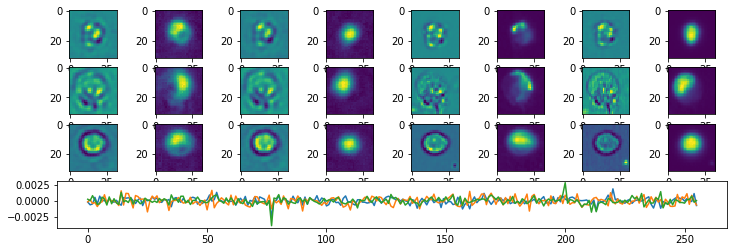

Epoch:  34 Iteration:  1000 Loss:  3.4455576 2.668283 0.7772747


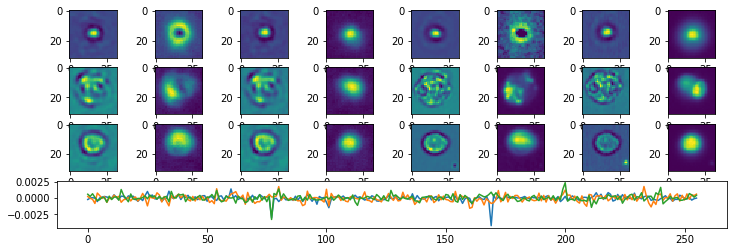

Epoch:  35 Iteration:  0 Loss:  3.5371583 2.7194824 0.8176759


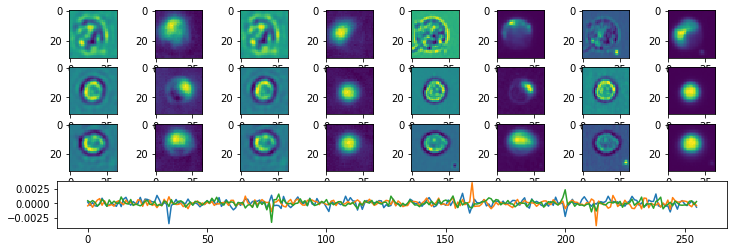

Epoch:  35 Iteration:  500 Loss:  10.807758 7.204327 3.6034317


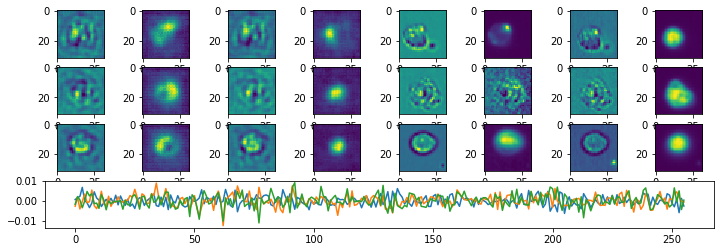

Epoch:  35 Iteration:  1000 Loss:  4.5485406 3.14889 1.3996506


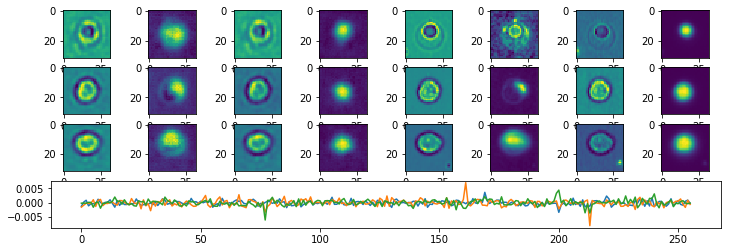

Epoch:  36 Iteration:  0 Loss:  3.9955456 2.807606 1.1879396


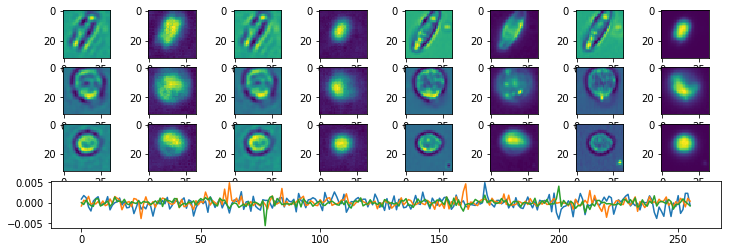

Epoch:  36 Iteration:  500 Loss:  3.9372425 2.8731341 1.0641085


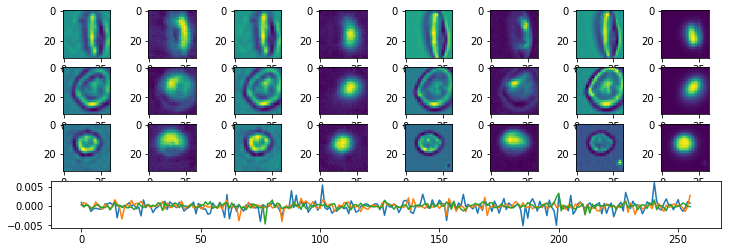

Epoch:  36 Iteration:  1000 Loss:  3.7725625 2.7997706 0.9727918


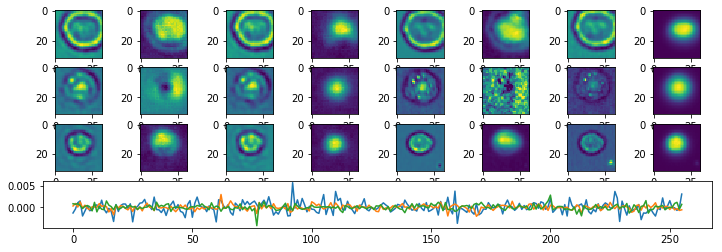

Epoch:  37 Iteration:  0 Loss:  3.6033006 2.663878 0.9394226


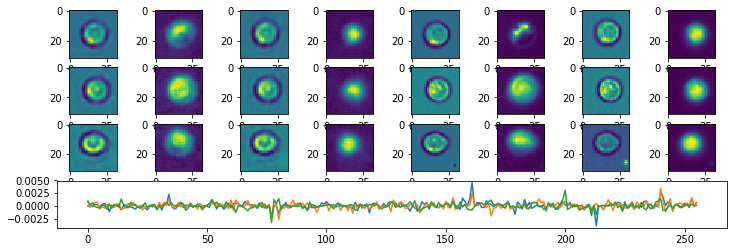

Epoch:  37 Iteration:  500 Loss:  3.6283712 2.747944 0.8804272


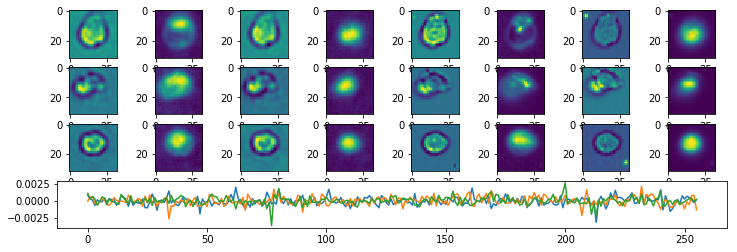

Epoch:  37 Iteration:  1000 Loss:  3.8616414 2.878767 0.9828744


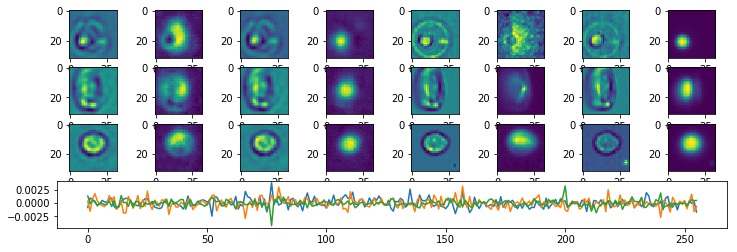

Epoch:  38 Iteration:  0 Loss:  3.3661914 2.5835137 0.78267777


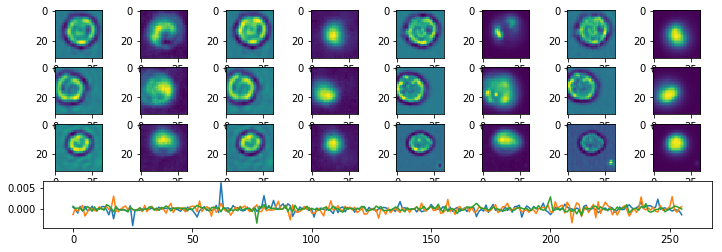

Epoch:  38 Iteration:  500 Loss:  7.4108114 4.7550564 2.6557553


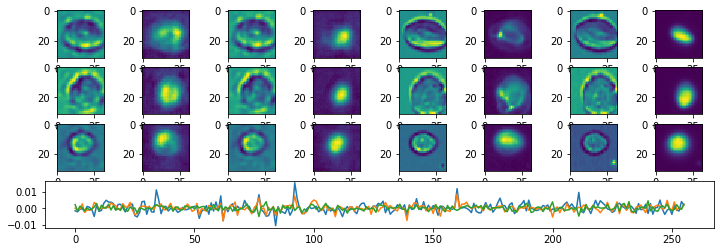

Epoch:  38 Iteration:  1000 Loss:  10.590518 7.405477 3.1850407


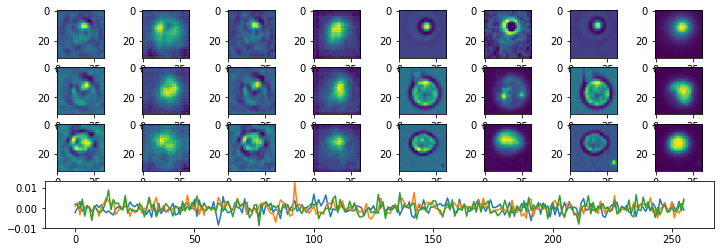

Epoch:  39 Iteration:  0 Loss:  4.3196917 2.9409835 1.378708


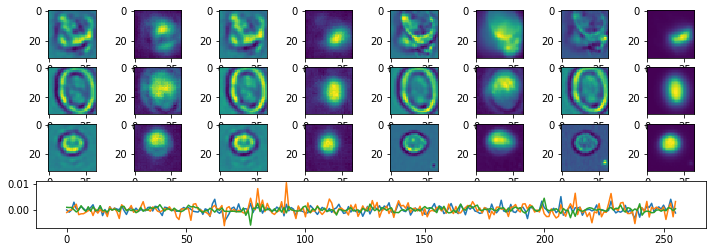

Epoch:  39 Iteration:  500 Loss:  3.9639401 2.7998557 1.1640843


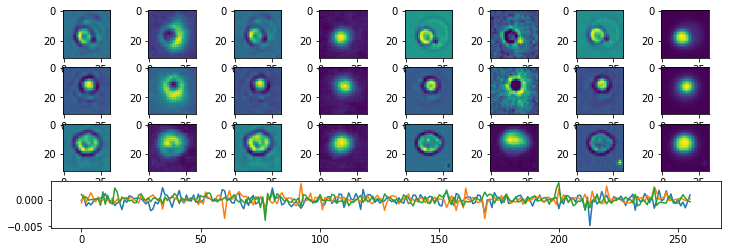

Epoch:  39 Iteration:  1000 Loss:  3.7284367 2.7823405 0.94609624


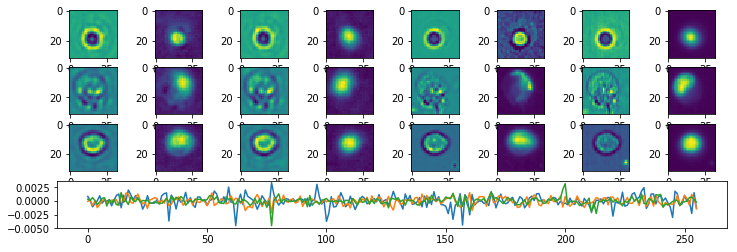

Epoch:  40 Iteration:  0 Loss:  3.4292264 2.5651708 0.86405563


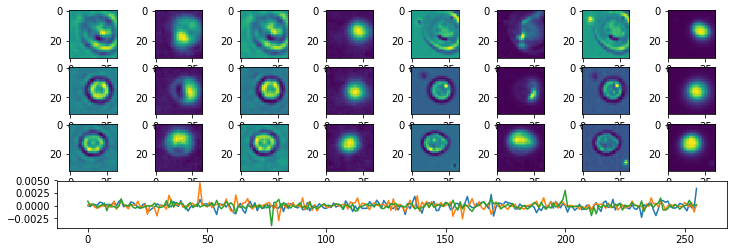

Epoch:  40 Iteration:  500 Loss:  3.6218936 2.782309 0.8395845


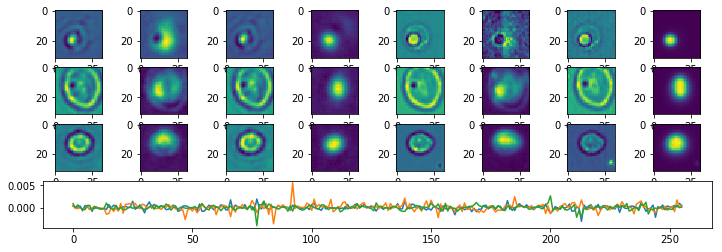

Epoch:  40 Iteration:  1000 Loss:  3.3926547 2.6209364 0.7717182


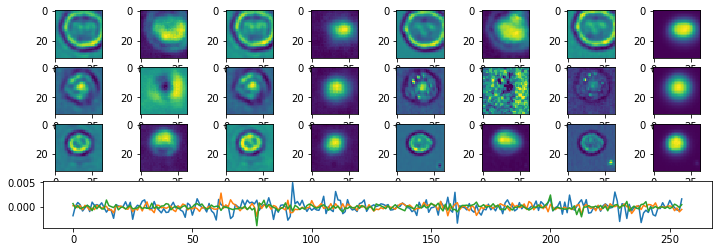

Epoch:  41 Iteration:  0 Loss:  3.2560172 2.5114508 0.74456644


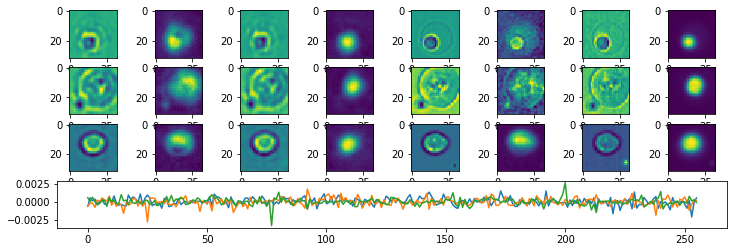

Epoch:  41 Iteration:  500 Loss:  4.3304634 2.876268 1.4541954


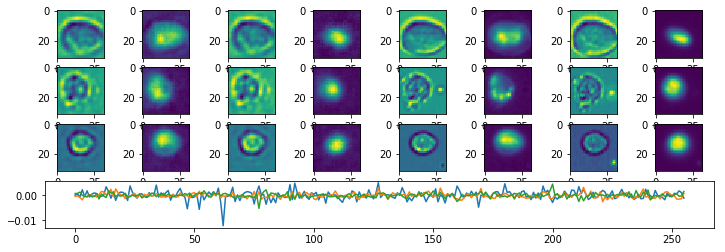

Epoch:  41 Iteration:  1000 Loss:  3.7381892 2.7286296 1.0095598


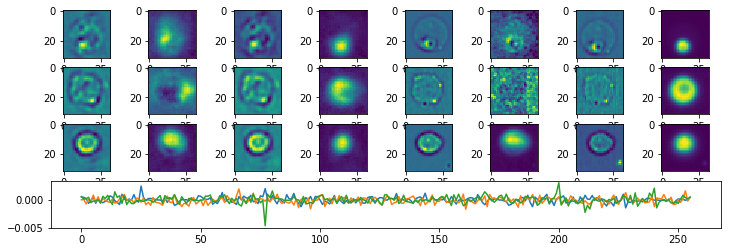

Epoch:  42 Iteration:  0 Loss:  3.4192412 2.5126534 0.9065879


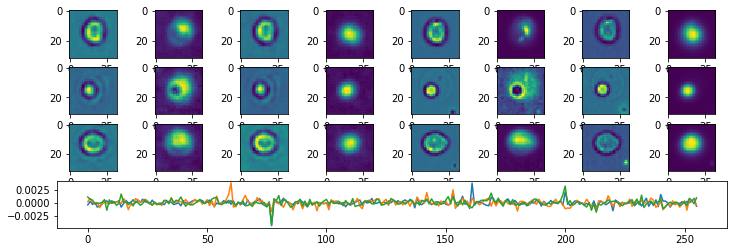

Epoch:  42 Iteration:  500 Loss:  3.4749186 2.6173413 0.8575773


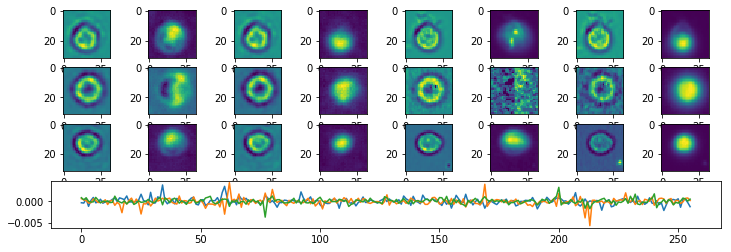

Epoch:  42 Iteration:  1000 Loss:  3.3140779 2.5147784 0.7992994


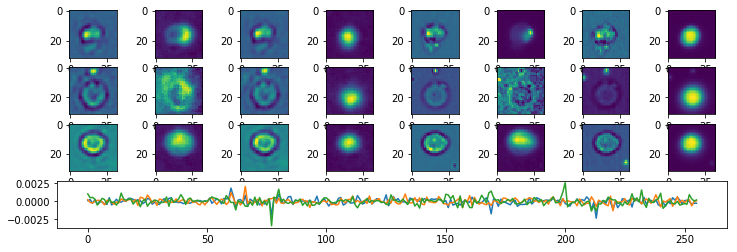

Epoch:  43 Iteration:  0 Loss:  3.3103805 2.4515371 0.85884327


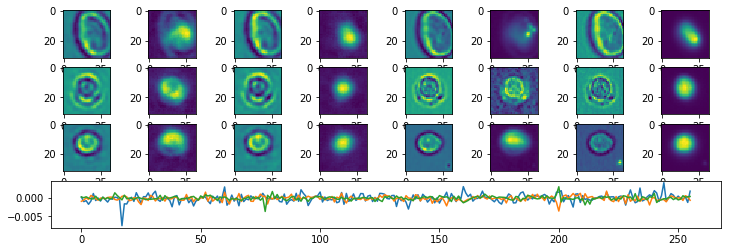

Epoch:  43 Iteration:  500 Loss:  3.3888466 2.6185718 0.77027494


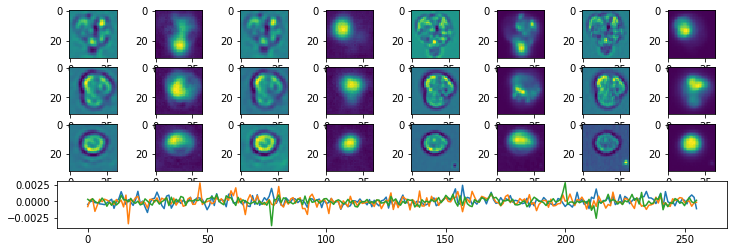

Epoch:  43 Iteration:  1000 Loss:  3.3438997 2.5967474 0.74715245


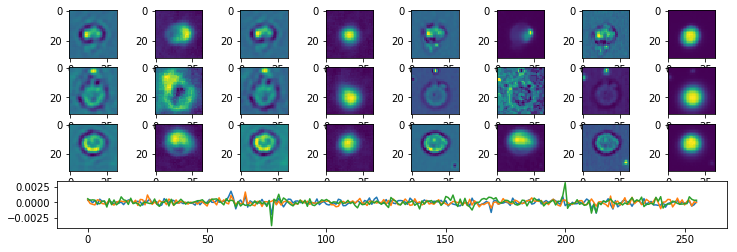

Epoch:  44 Iteration:  0 Loss:  3.102514 2.378306 0.7242081


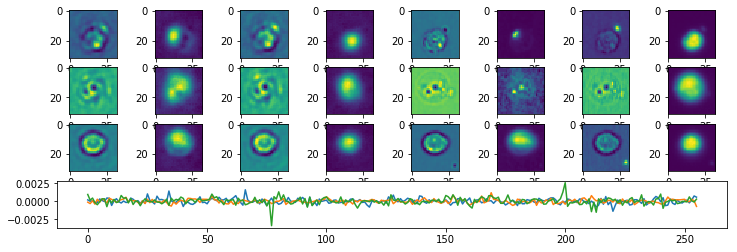

Epoch:  44 Iteration:  500 Loss:  6.157881 4.084265 2.0736153


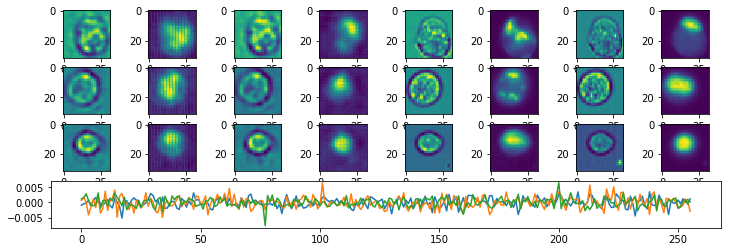

Epoch:  44 Iteration:  1000 Loss:  3.9678717 2.7204216 1.2474501


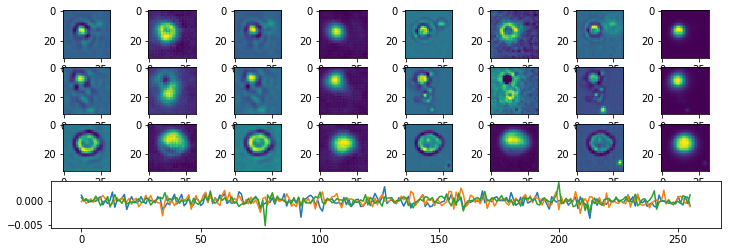

Epoch:  45 Iteration:  0 Loss:  3.5938401 2.5551853 1.0386547


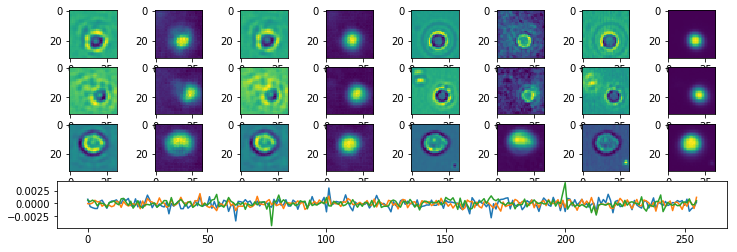

Epoch:  45 Iteration:  500 Loss:  3.5617747 2.6047502 0.9570246


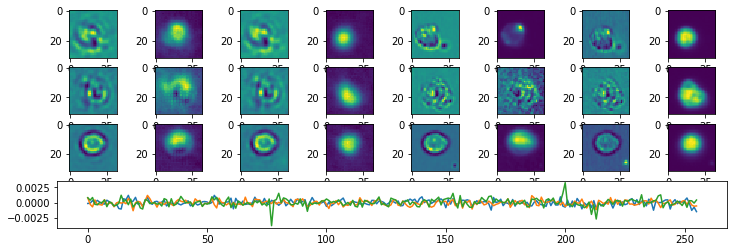

Epoch:  45 Iteration:  1000 Loss:  3.4796278 2.5958703 0.8837576


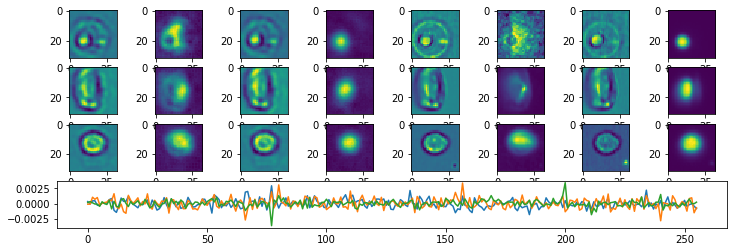

Epoch:  46 Iteration:  0 Loss:  3.233119 2.3830388 0.8500803


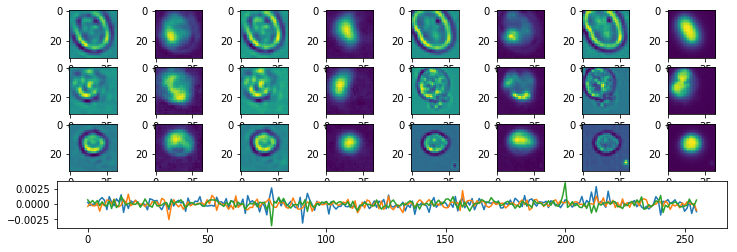

Epoch:  46 Iteration:  500 Loss:  3.5405216 2.6976228 0.84289896


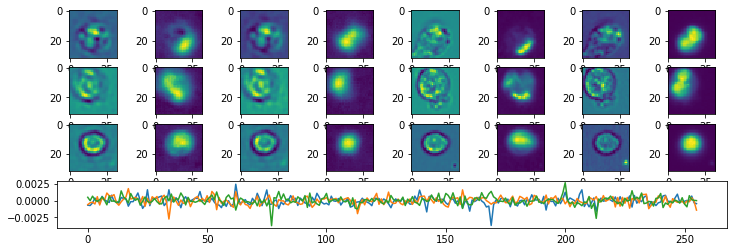

Epoch:  46 Iteration:  1000 Loss:  3.3043432 2.5304894 0.7738537


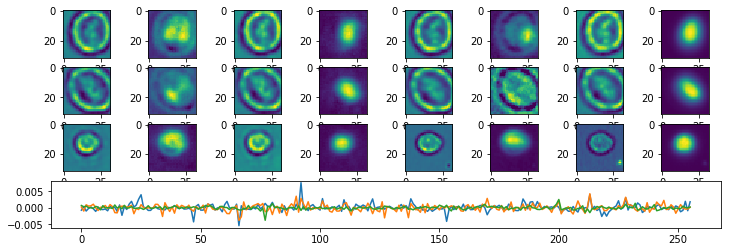

Epoch:  47 Iteration:  0 Loss:  3.1765406 2.3967495 0.77979106


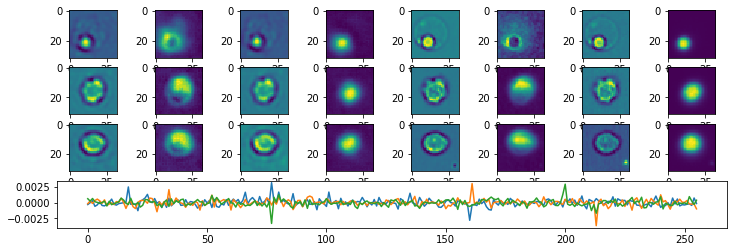

Epoch:  47 Iteration:  500 Loss:  9.771881 6.7367616 3.03512


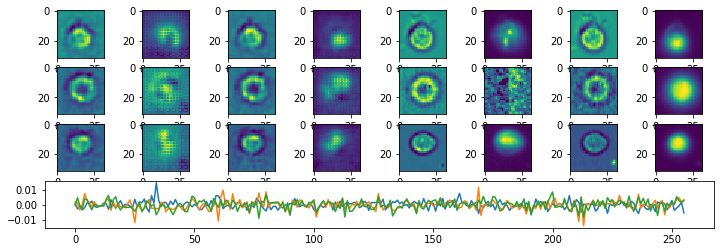

Epoch:  47 Iteration:  1000 Loss:  3.7691672 2.6844196 1.0847476


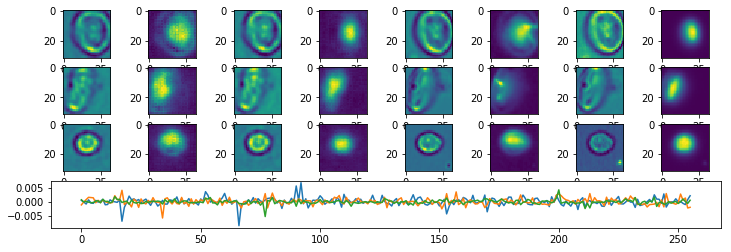

Epoch:  48 Iteration:  0 Loss:  3.3260143 2.4183388 0.90767556


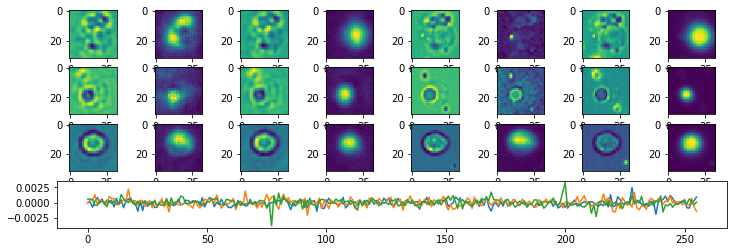

Epoch:  48 Iteration:  500 Loss:  3.5770764 2.6485536 0.9285229


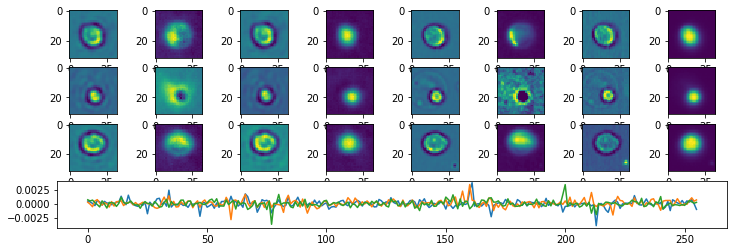

Epoch:  48 Iteration:  1000 Loss:  3.1890078 2.3921835 0.79682434


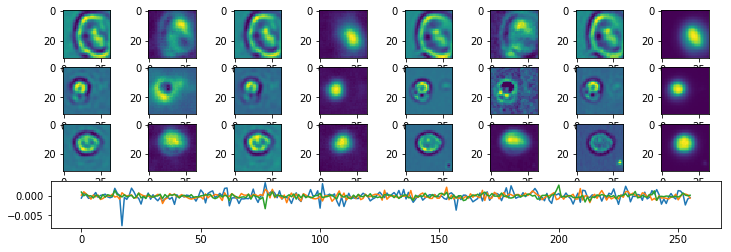

Epoch:  49 Iteration:  0 Loss:  3.1321902 2.3584151 0.77377504


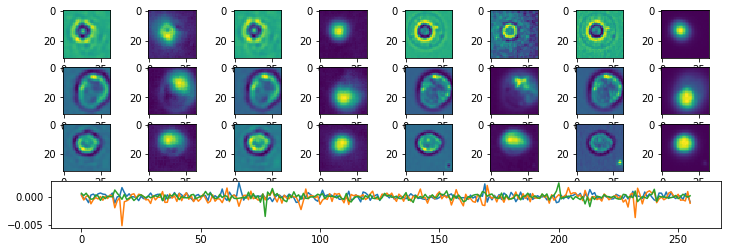

Epoch:  49 Iteration:  500 Loss:  3.216371 2.4418526 0.7745184


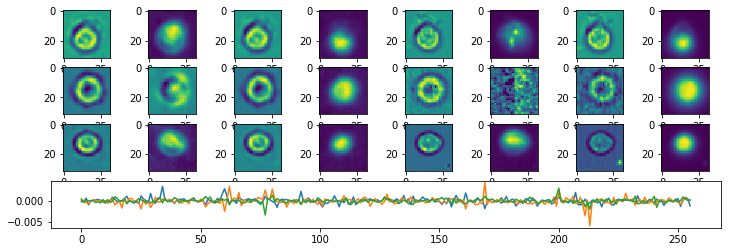

Epoch:  49 Iteration:  1000 Loss:  3.0452638 2.317984 0.72727954


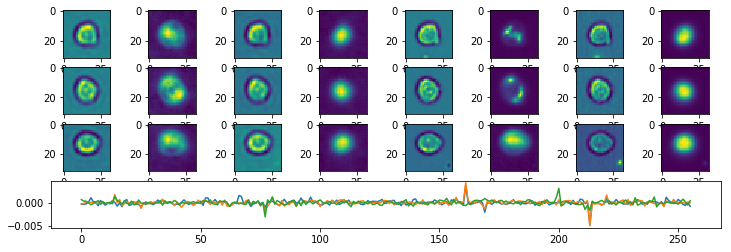

Epoch:  50 Iteration:  0 Loss:  5.5927925 3.6305735 1.9622192


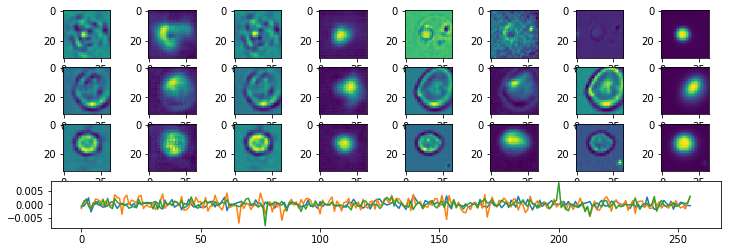

Epoch:  50 Iteration:  500 Loss:  3.9512196 2.7029781 1.2482415


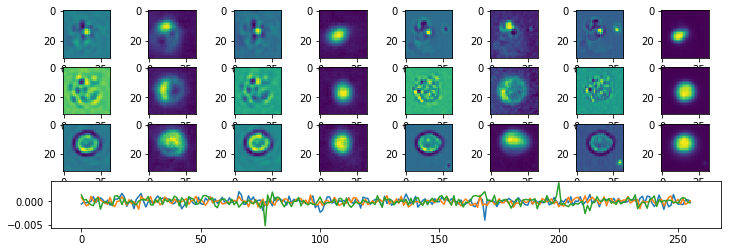

Epoch:  50 Iteration:  1000 Loss:  3.614573 2.5811205 1.0334524


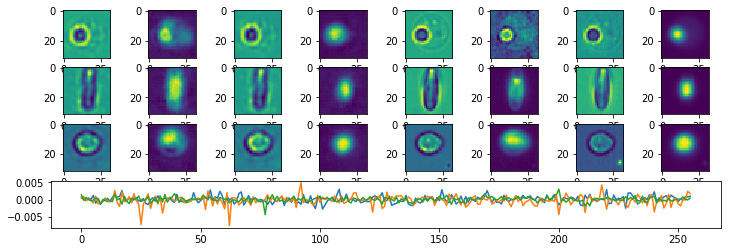

Epoch:  51 Iteration:  0 Loss:  3.3640773 2.4310846 0.93299276


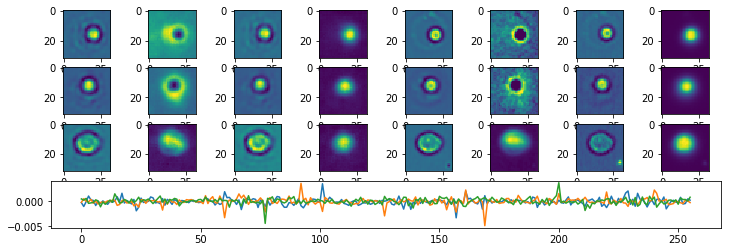

Epoch:  51 Iteration:  500 Loss:  3.6208758 2.615804 1.005072


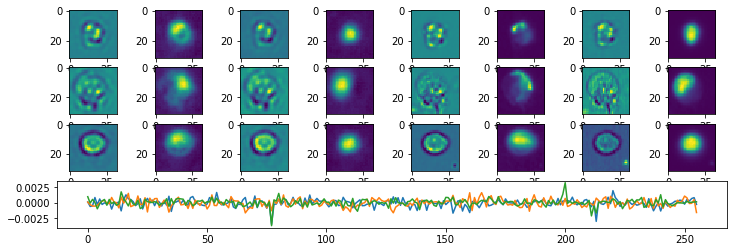

Epoch:  51 Iteration:  1000 Loss:  3.1423602 2.3489237 0.79343665


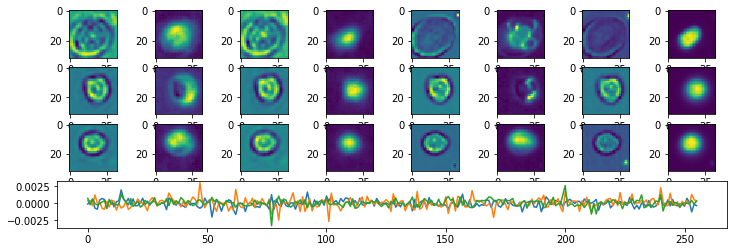

Epoch:  52 Iteration:  0 Loss:  3.090748 2.33804 0.7527079


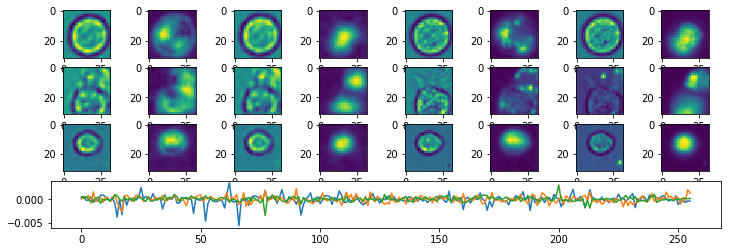

Epoch:  52 Iteration:  500 Loss:  3.3866541 2.4845407 0.9021134


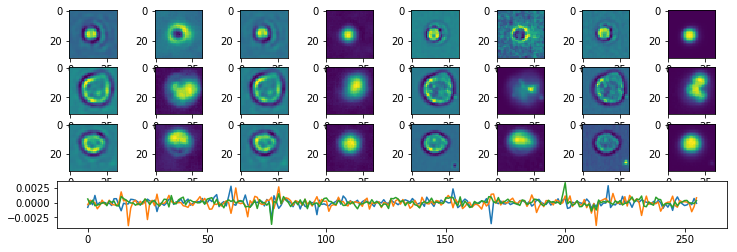

Epoch:  52 Iteration:  1000 Loss:  3.7725203 2.6766148 1.0959055


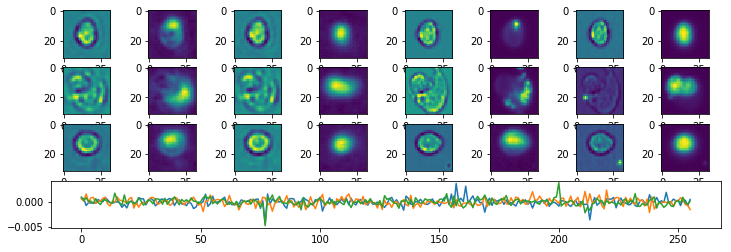

Epoch:  53 Iteration:  0 Loss:  3.0655725 2.3032665 0.7623059


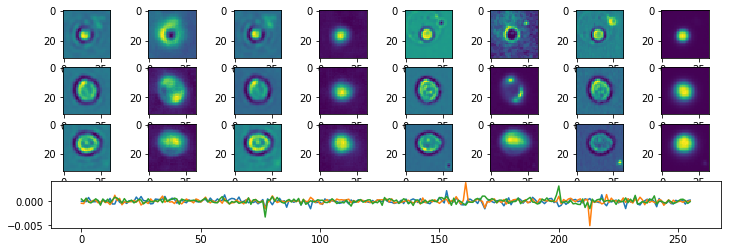

Epoch:  53 Iteration:  500 Loss:  3.3410149 2.37951 0.96150494


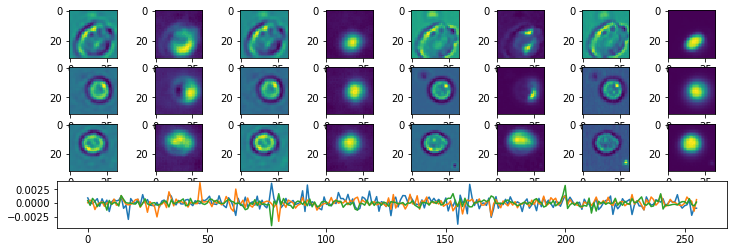

Epoch:  53 Iteration:  1000 Loss:  6.2247996 3.965631 2.2591686


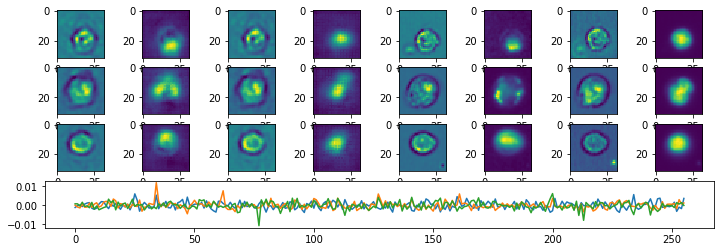

Epoch:  54 Iteration:  0 Loss:  3.788625 2.5373397 1.2512853


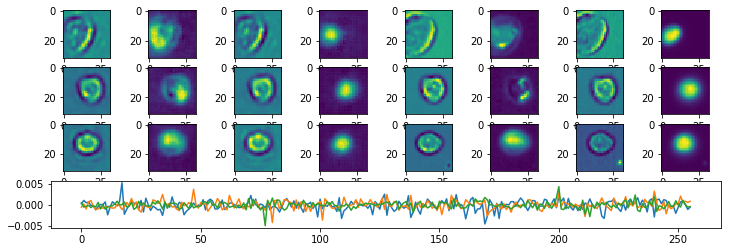

Epoch:  54 Iteration:  500 Loss:  3.4951355 2.4918575 1.003278


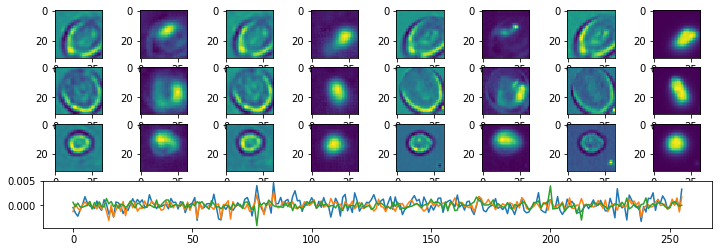

Epoch:  54 Iteration:  1000 Loss:  3.3366997 2.4456332 0.89106655


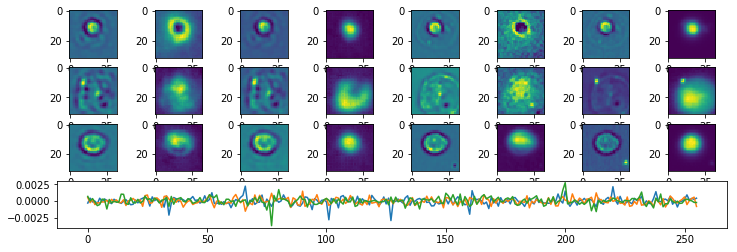

Epoch:  55 Iteration:  0 Loss:  3.0937467 2.2788749 0.8148717


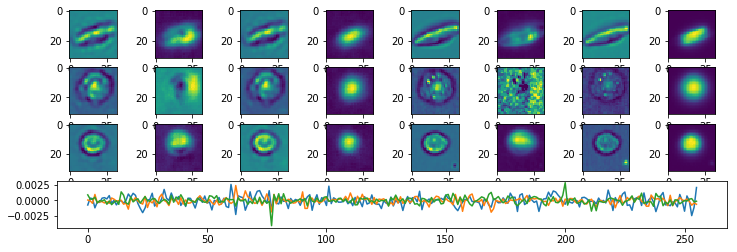

Epoch:  55 Iteration:  500 Loss:  3.269121 2.4894505 0.7796704


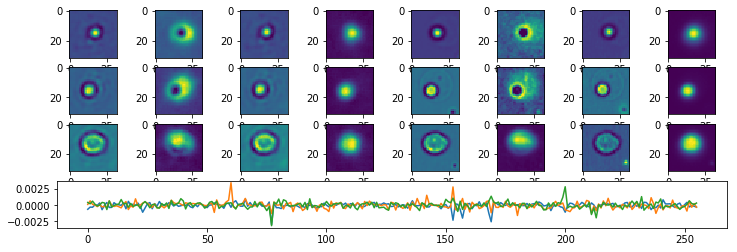

Epoch:  55 Iteration:  1000 Loss:  3.0916018 2.2963336 0.79526824


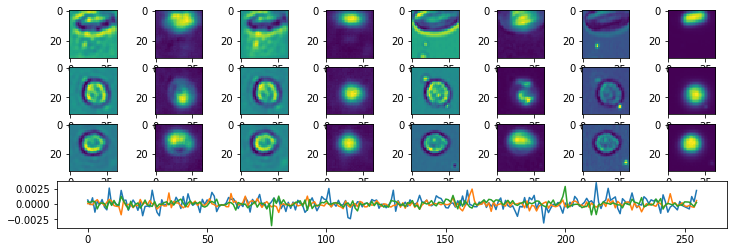

Epoch:  56 Iteration:  0 Loss:  3.0140104 2.2808053 0.733205


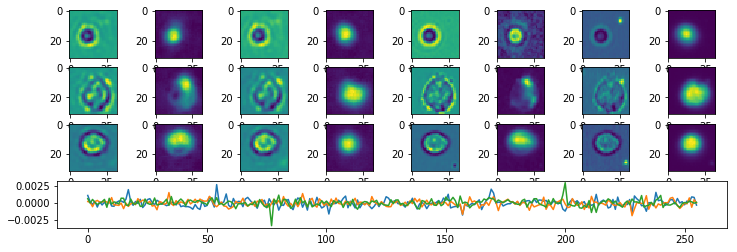

Epoch:  56 Iteration:  500 Loss:  3.0962853 2.3729477 0.7233376


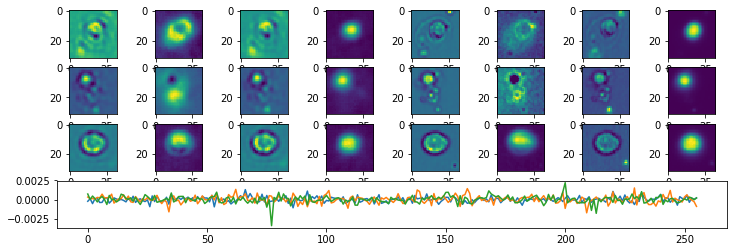

Epoch:  56 Iteration:  1000 Loss:  3.0246058 2.260037 0.76456875


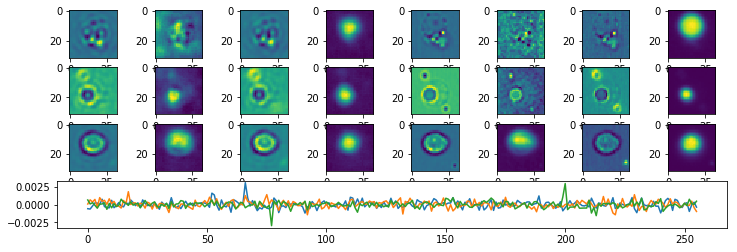

Epoch:  57 Iteration:  0 Loss:  5.606499 3.3784432 2.228056


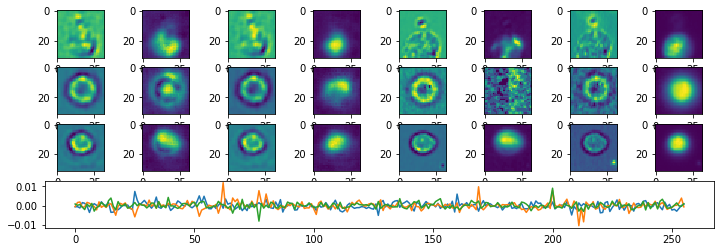

Epoch:  57 Iteration:  500 Loss:  3.286275 2.4053001 0.8809749


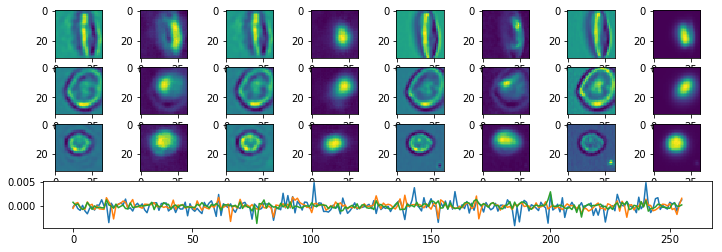

Epoch:  57 Iteration:  1000 Loss:  2.9959958 2.2401721 0.75582355


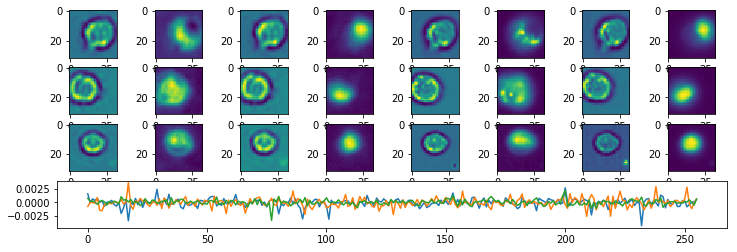

Epoch:  58 Iteration:  0 Loss:  2.967658 2.1913962 0.77626175


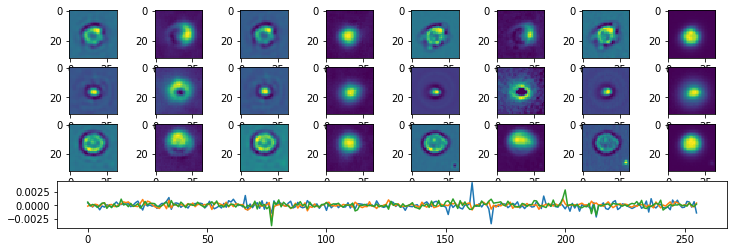

Epoch:  58 Iteration:  500 Loss:  3.1267493 2.3647127 0.7620366


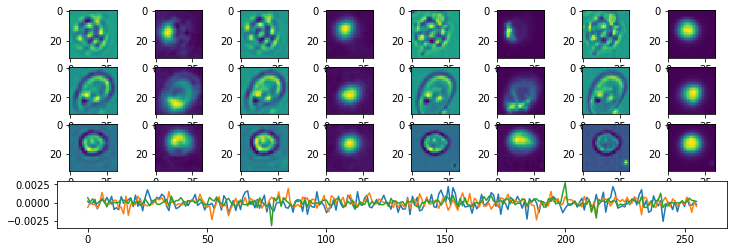

Epoch:  58 Iteration:  1000 Loss:  2.9107428 2.231194 0.6795487


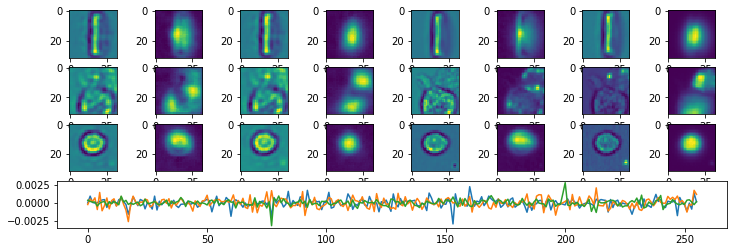

Epoch:  59 Iteration:  0 Loss:  4.9013333 3.094471 1.8068625


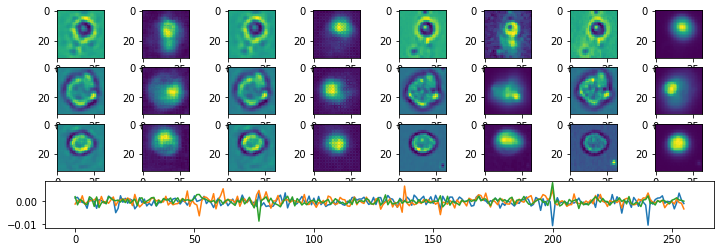

Epoch:  59 Iteration:  500 Loss:  3.982671 2.6713073 1.3113637


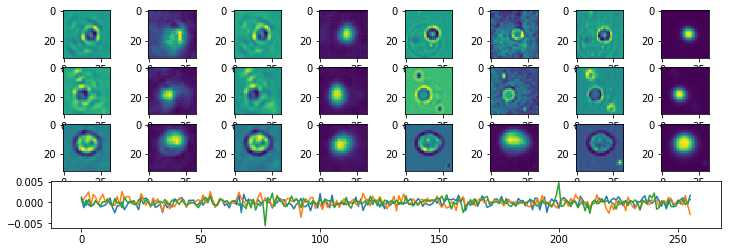

Epoch:  59 Iteration:  1000 Loss:  3.734087 2.5153828 1.2187042


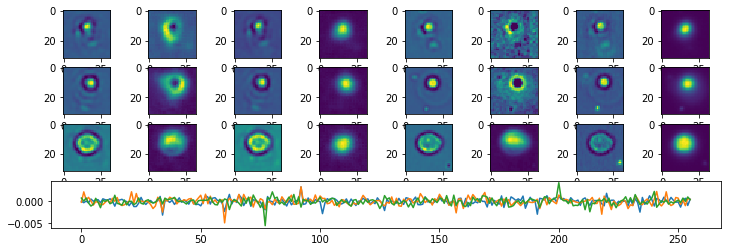

Epoch:  60 Iteration:  0 Loss:  3.1989083 2.2347457 0.96416265


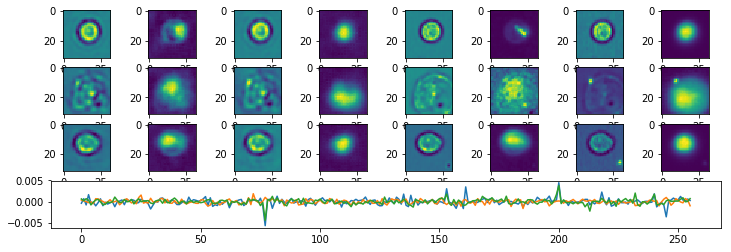

Epoch:  60 Iteration:  500 Loss:  3.262041 2.3642812 0.89775985


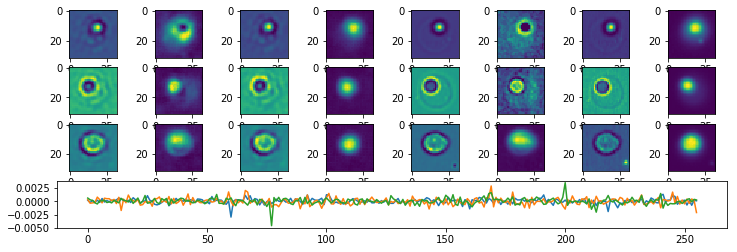

Epoch:  60 Iteration:  1000 Loss:  3.1086996 2.2929664 0.81573313


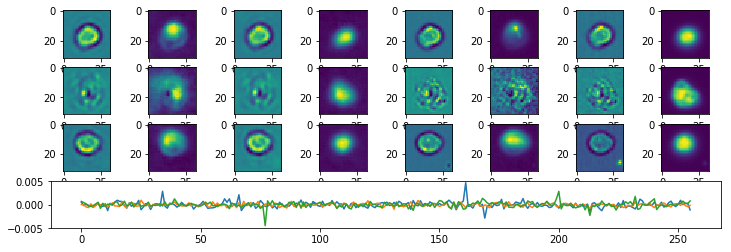

Epoch:  61 Iteration:  0 Loss:  2.9152417 2.1624951 0.7527467


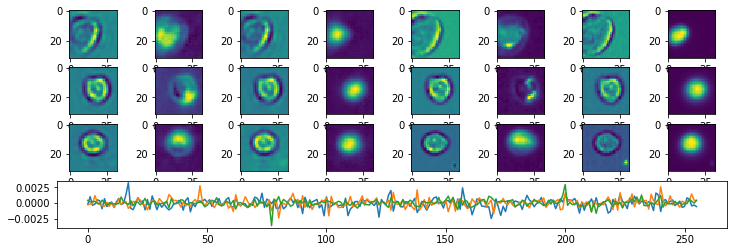

Epoch:  61 Iteration:  500 Loss:  5.2669334 3.2016888 2.0652444


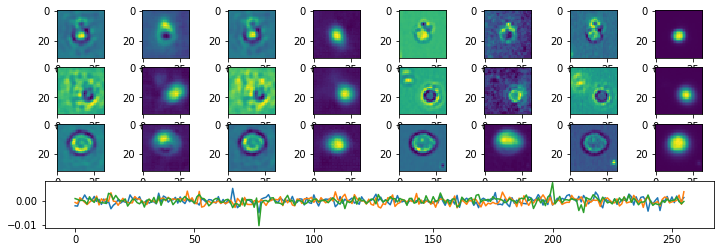

Epoch:  61 Iteration:  1000 Loss:  3.4449263 2.4064224 1.038504


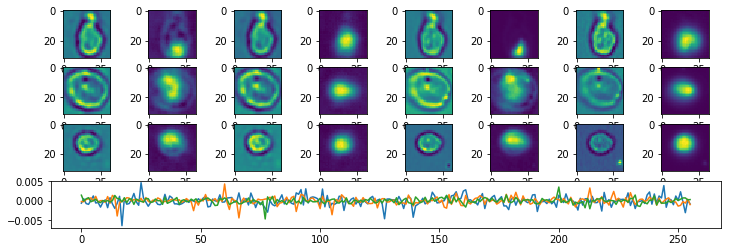

Epoch:  62 Iteration:  0 Loss:  3.108429 2.2378676 0.87056124


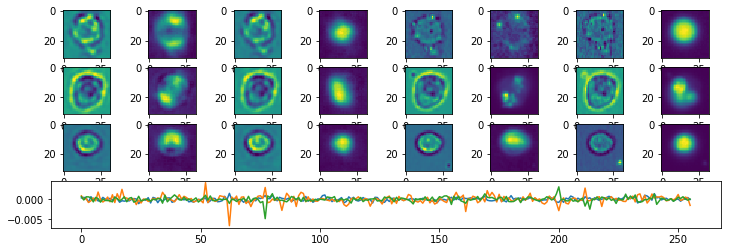

Epoch:  62 Iteration:  500 Loss:  3.1572926 2.3250813 0.8322113


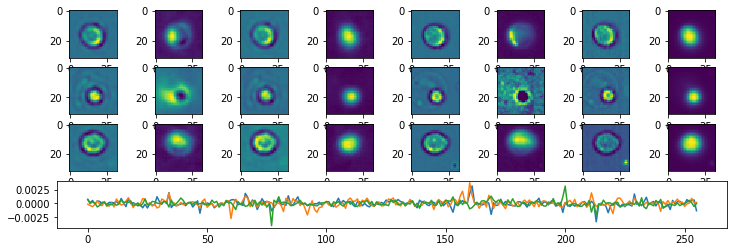

Epoch:  62 Iteration:  1000 Loss:  2.975292 2.2031713 0.7721208


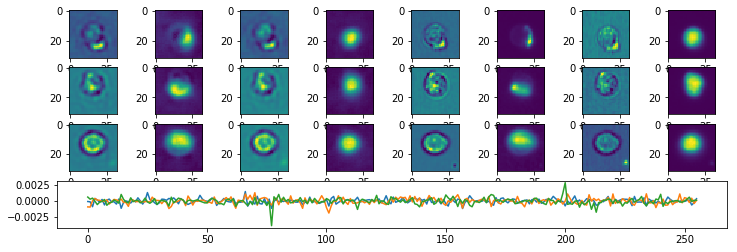

Epoch:  63 Iteration:  0 Loss:  18.214674 11.237577 6.977096


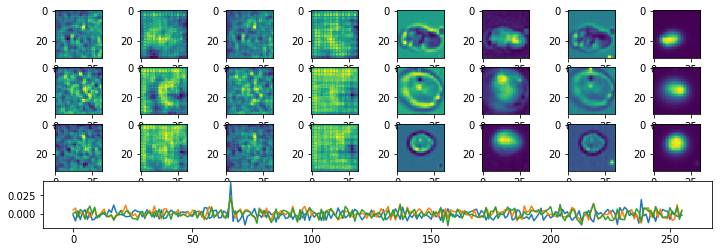

Epoch:  63 Iteration:  500 Loss:  4.0373673 2.6371684 1.4001988


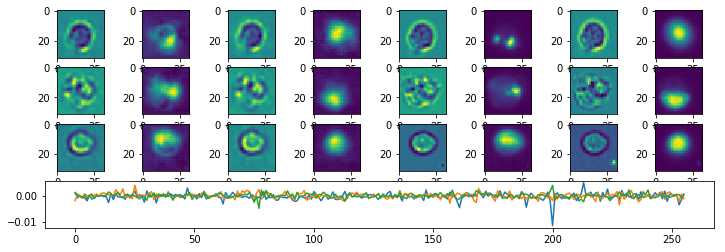

Epoch:  63 Iteration:  1000 Loss:  3.3693225 2.3506293 1.0186932


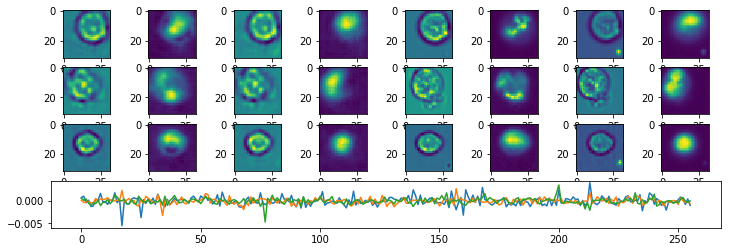

Epoch:  64 Iteration:  0 Loss:  3.101767 2.1844306 0.9173366


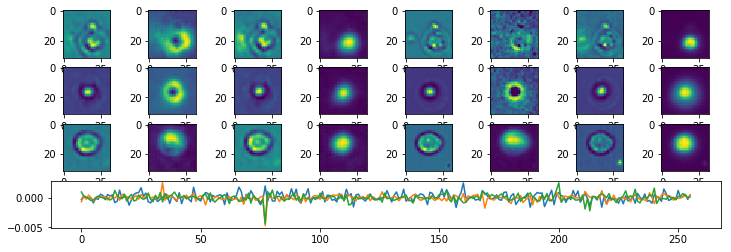

Epoch:  64 Iteration:  500 Loss:  3.224261 2.3103924 0.9138687


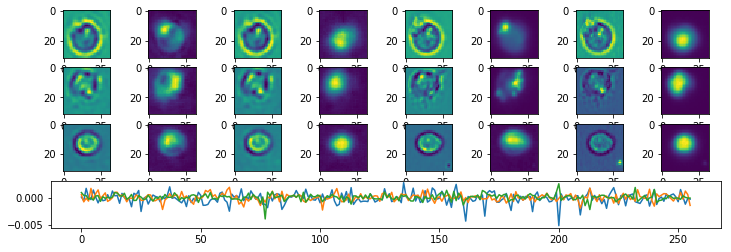

Epoch:  64 Iteration:  1000 Loss:  3.0060952 2.2002158 0.8058794


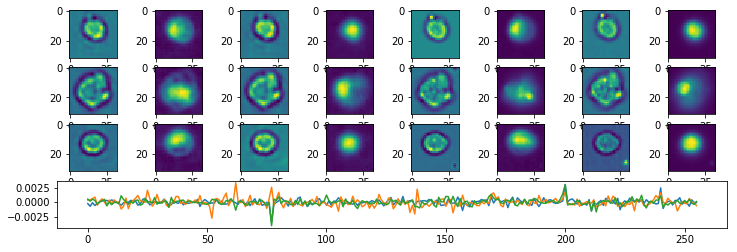

Epoch:  65 Iteration:  0 Loss:  2.9178307 2.1409137 0.7769169


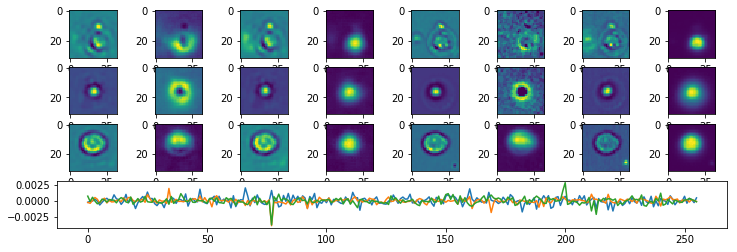

Epoch:  65 Iteration:  500 Loss:  3.0497417 2.270073 0.7796687


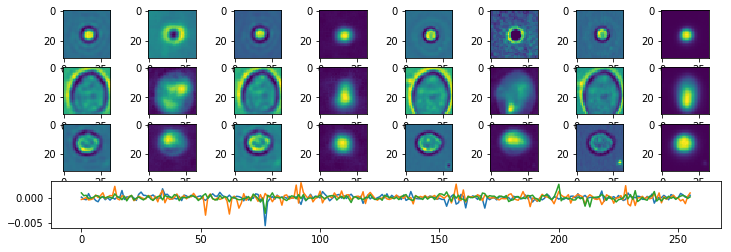

Epoch:  65 Iteration:  1000 Loss:  3.02845 2.2953324 0.7331176


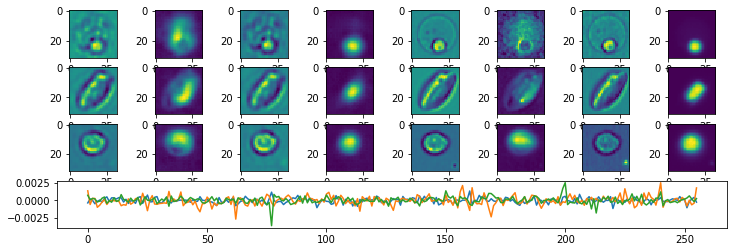

Epoch:  66 Iteration:  0 Loss:  3.2045834 2.2874937 0.91708964


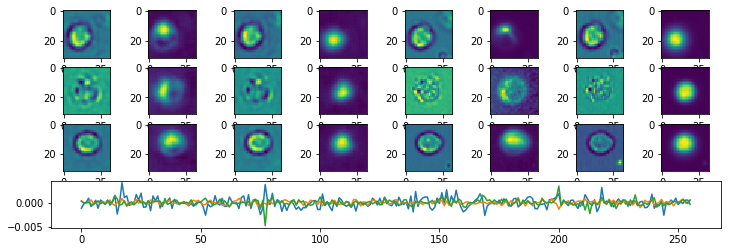

Epoch:  66 Iteration:  500 Loss:  2.9794047 2.20543 0.7739747


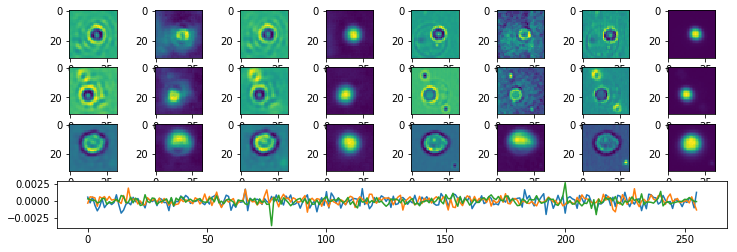

Epoch:  66 Iteration:  1000 Loss:  4.305666 2.755999 1.5496669


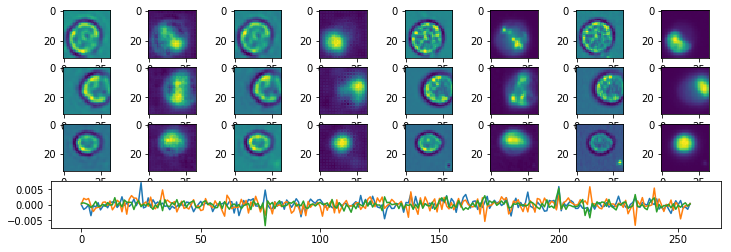

Epoch:  67 Iteration:  0 Loss:  3.421072 2.359612 1.0614599


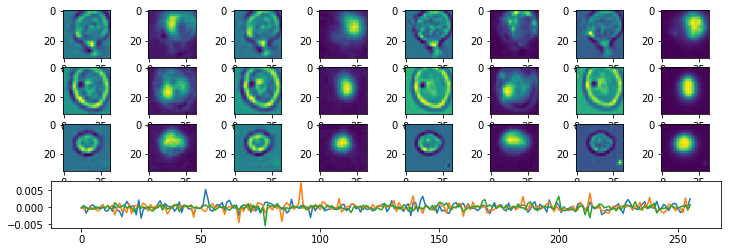

Epoch:  67 Iteration:  500 Loss:  3.2881298 2.3427205 0.9454093


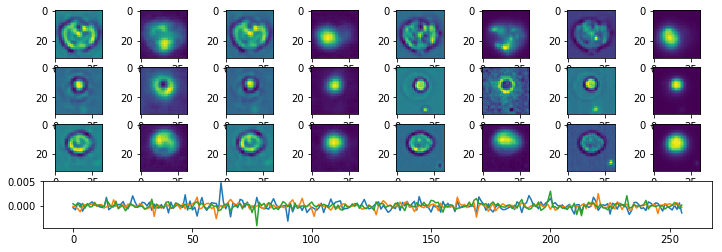

Epoch:  67 Iteration:  1000 Loss:  3.0733798 2.2410188 0.8323609


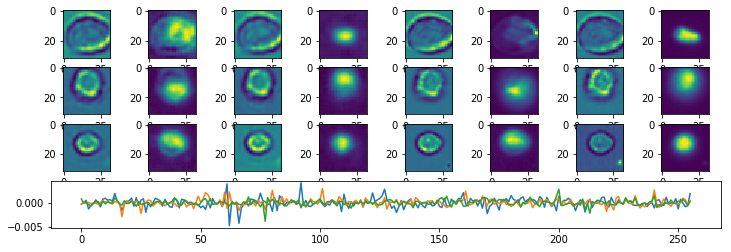

Epoch:  68 Iteration:  0 Loss:  2.8843453 2.1068618 0.77748346


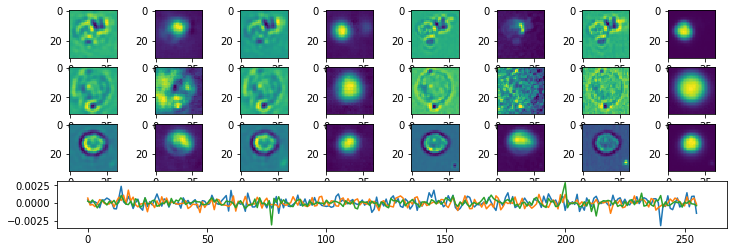

Epoch:  68 Iteration:  500 Loss:  2.9079983 2.1484532 0.75954515


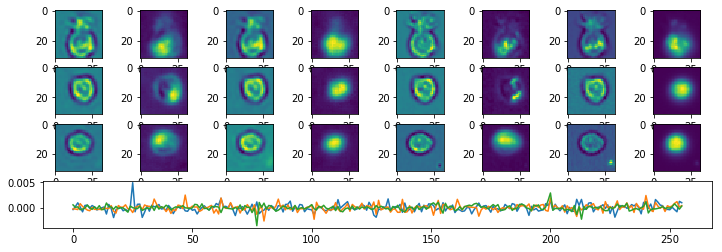

Epoch:  68 Iteration:  1000 Loss:  7.8206663 4.103671 3.7169952


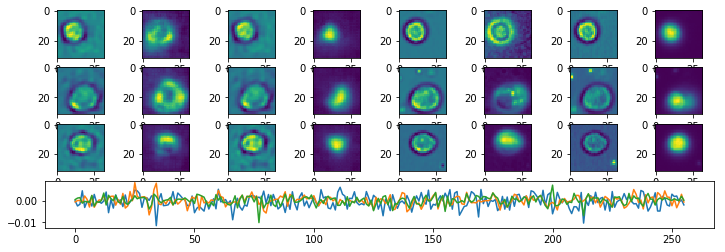

Epoch:  69 Iteration:  0 Loss:  2.7312012 2.0353084 0.69589275


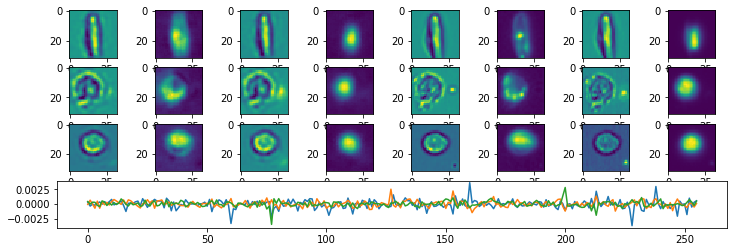

Epoch:  69 Iteration:  500 Loss:  2.9880726 2.2042794 0.7837932


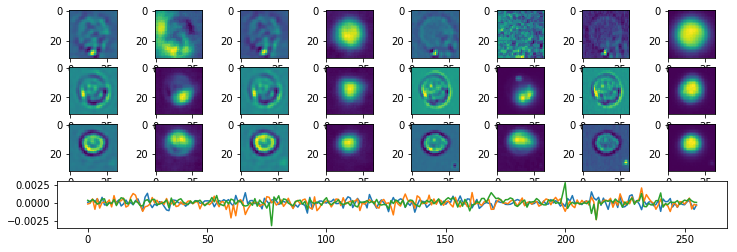

Epoch:  69 Iteration:  1000 Loss:  3.068015 2.3269484 0.7410667


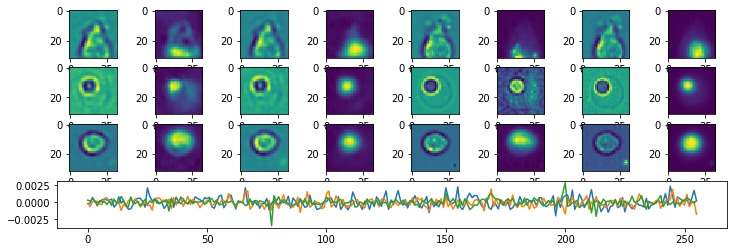

Epoch:  70 Iteration:  0 Loss:  4.6026173 2.8800282 1.7225888


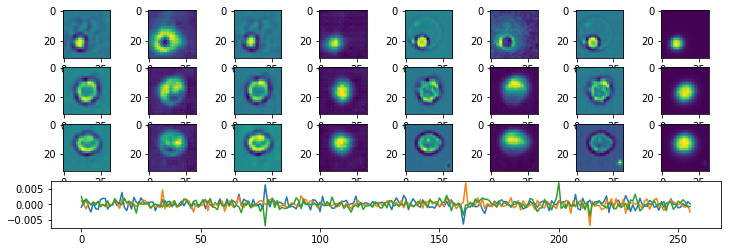

Epoch:  70 Iteration:  500 Loss:  3.5276475 2.4110572 1.1165904


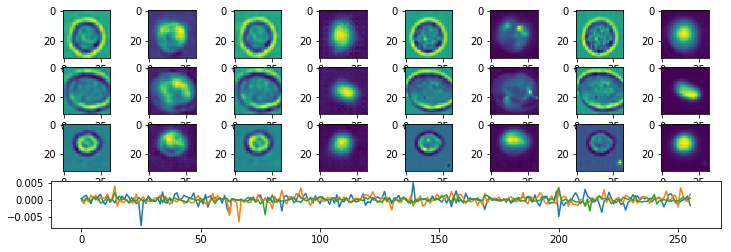

Epoch:  70 Iteration:  1000 Loss:  3.148804 2.2365265 0.9122774


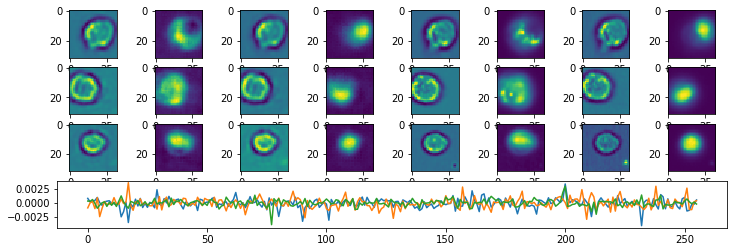

Epoch:  71 Iteration:  0 Loss:  3.03087 2.169837 0.8610331


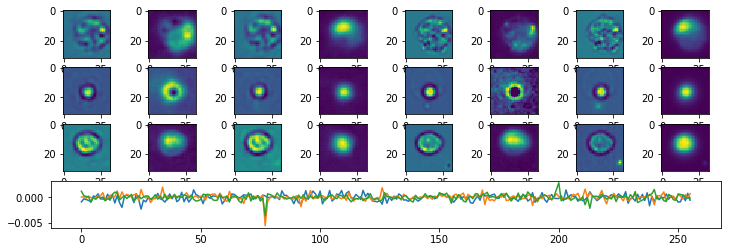

Epoch:  71 Iteration:  500 Loss:  3.1363554 2.312904 0.82345146


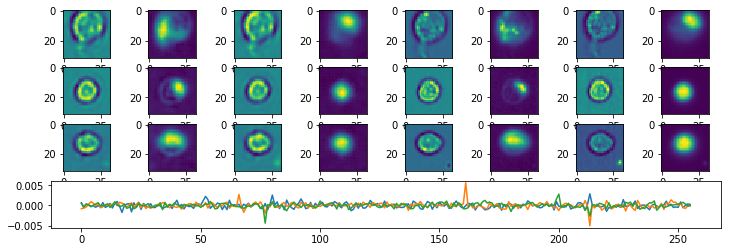

Epoch:  71 Iteration:  1000 Loss:  2.934072 2.1292791 0.8047928


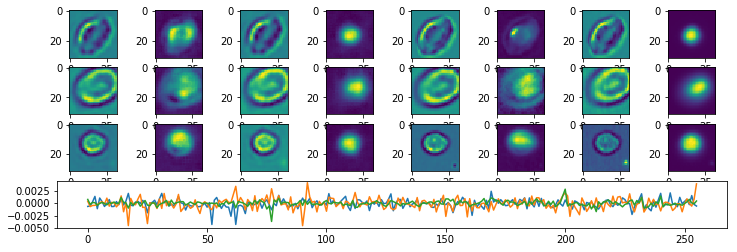

Epoch:  72 Iteration:  0 Loss:  2.824488 2.0921426 0.7323454


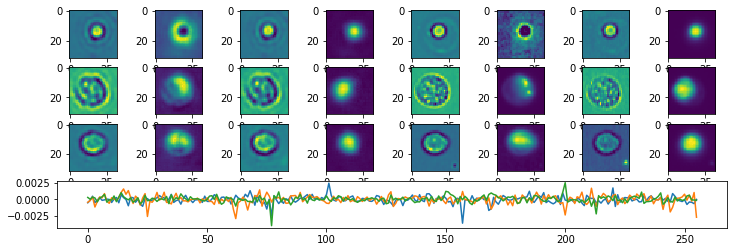

Epoch:  72 Iteration:  500 Loss:  4.8986616 2.9535875 1.9450741


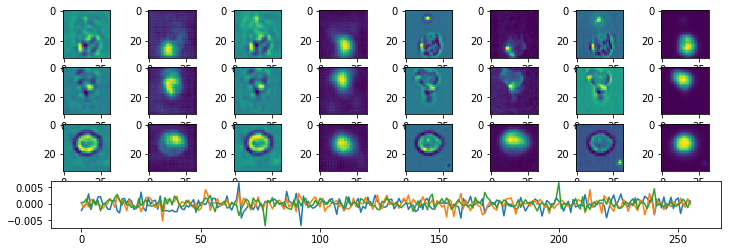

Epoch:  72 Iteration:  1000 Loss:  3.4657245 2.371238 1.0944866


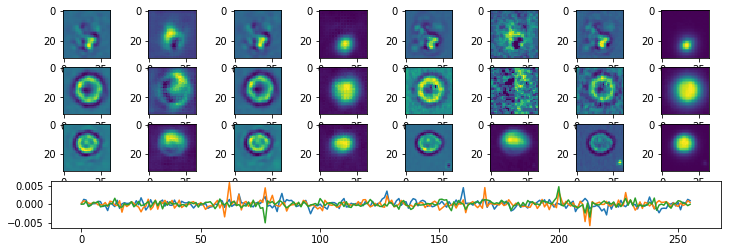

Epoch:  73 Iteration:  0 Loss:  3.1706803 2.1937785 0.9769017


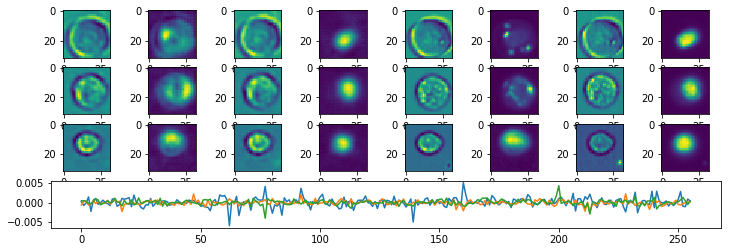

Epoch:  73 Iteration:  500 Loss:  3.2045925 2.2898517 0.91474086


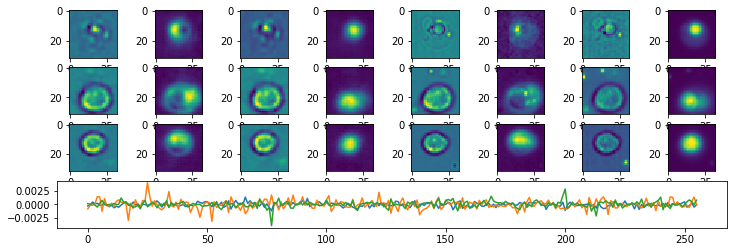

Epoch:  73 Iteration:  1000 Loss:  3.0597284 2.2361093 0.82361907


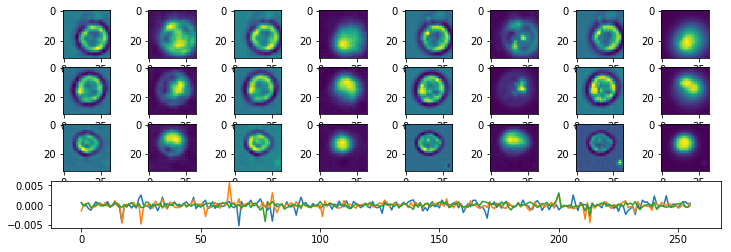

Epoch:  74 Iteration:  0 Loss:  2.8108368 2.0476928 0.76314396


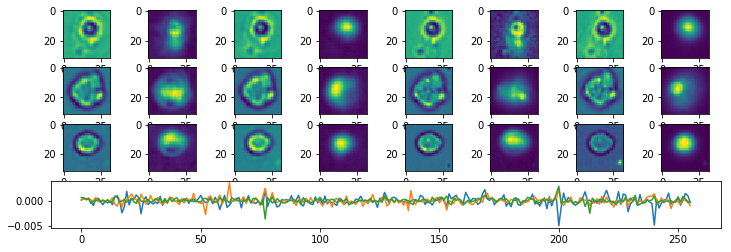

Epoch:  74 Iteration:  500 Loss:  2.9951198 2.219625 0.7754948


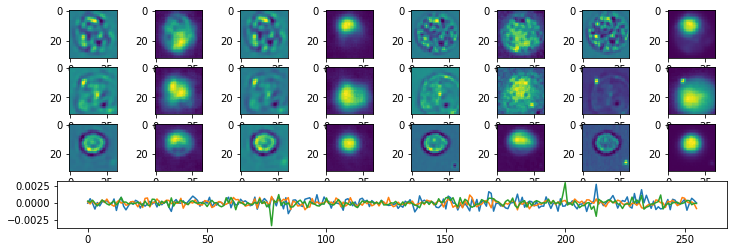

Epoch:  74 Iteration:  1000 Loss:  2.9022589 2.1346633 0.76759547


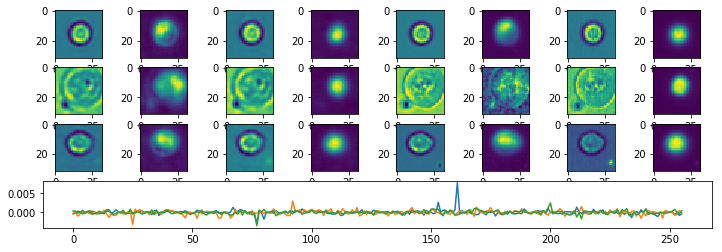

Epoch:  75 Iteration:  0 Loss:  4.703808 3.0689313 1.6348766


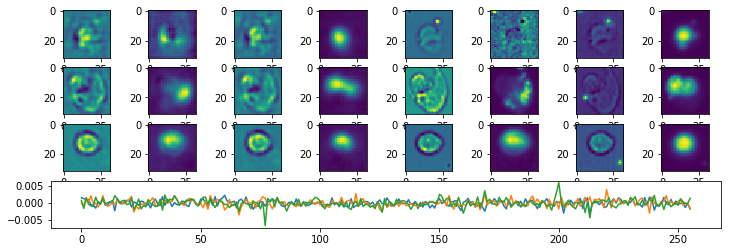

Epoch:  75 Iteration:  500 Loss:  4.2116013 2.6954973 1.5161041


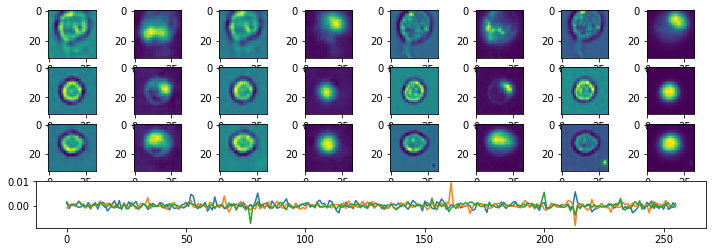

Epoch:  75 Iteration:  1000 Loss:  3.4513576 2.3908339 1.0605237


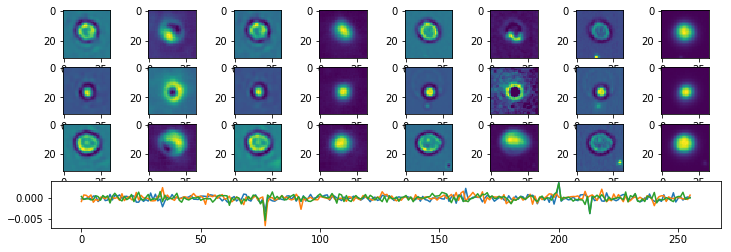

Epoch:  76 Iteration:  0 Loss:  3.0158887 2.108523 0.90736574


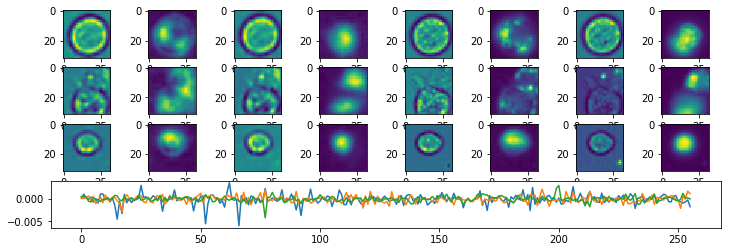

Epoch:  76 Iteration:  500 Loss:  3.0247123 2.2043428 0.8203694


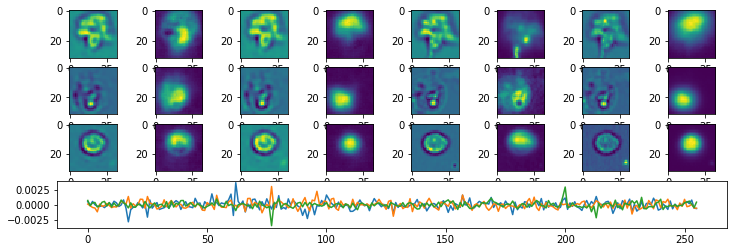

Epoch:  76 Iteration:  1000 Loss:  2.9411757 2.167895 0.77328056


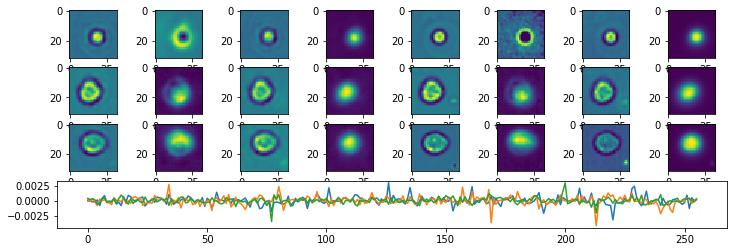

Epoch:  77 Iteration:  0 Loss:  2.9175928 2.1396441 0.77794856


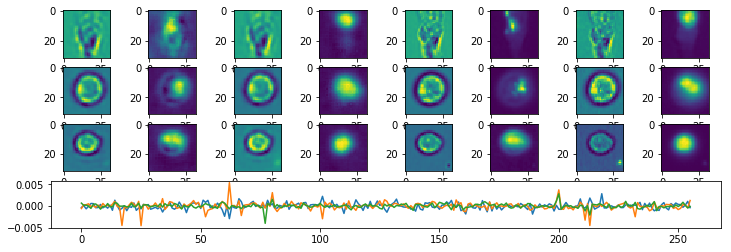

Epoch:  77 Iteration:  500 Loss:  2.8806996 2.1610267 0.7196728


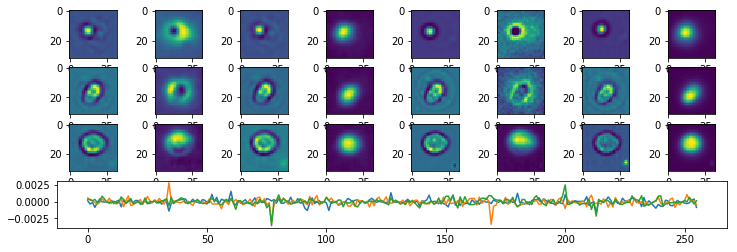

Epoch:  77 Iteration:  1000 Loss:  2.989192 2.2814646 0.70772743


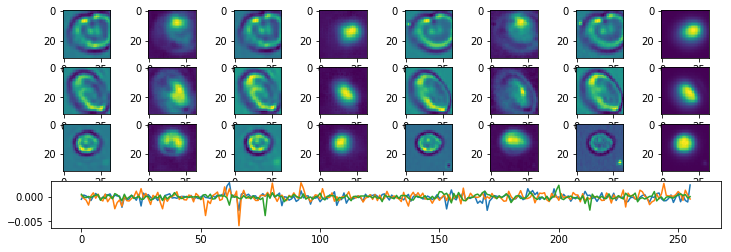

Epoch:  78 Iteration:  0 Loss:  13.412054 8.743126 4.6689277


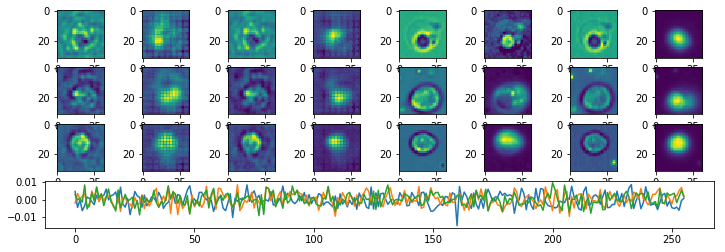

Epoch:  78 Iteration:  500 Loss:  3.574483 2.4550178 1.119465


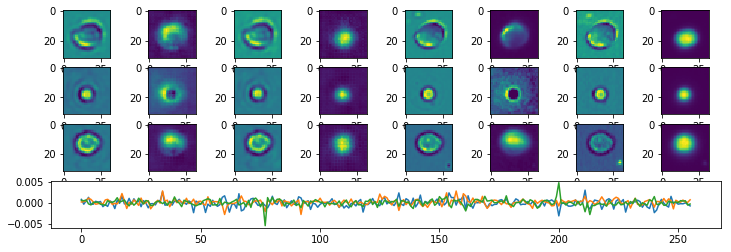

Epoch:  78 Iteration:  1000 Loss:  3.1877398 2.30688 0.88085985


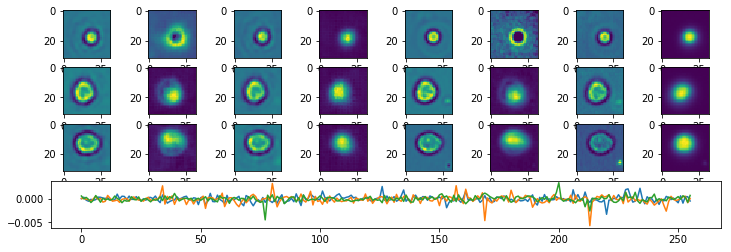

Epoch:  79 Iteration:  0 Loss:  2.889951 2.070012 0.81993884


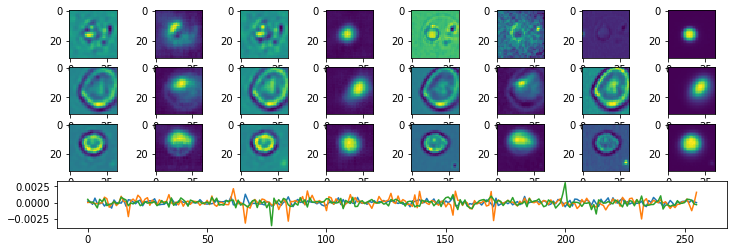

Epoch:  79 Iteration:  500 Loss:  3.019158 2.2460365 0.7731213


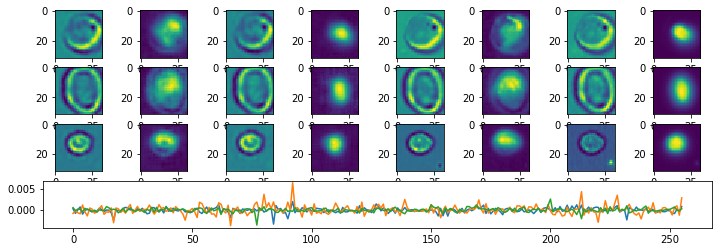

Epoch:  79 Iteration:  1000 Loss:  2.8574014 2.1023374 0.75506395


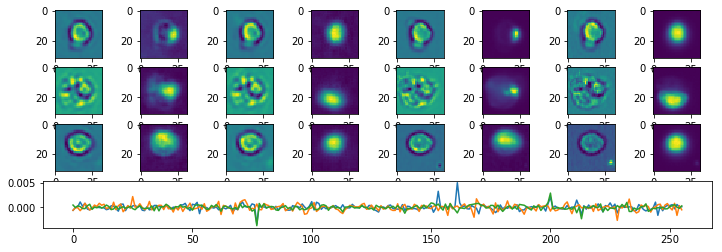

Epoch:  80 Iteration:  0 Loss:  2.6566095 1.9736886 0.6829209


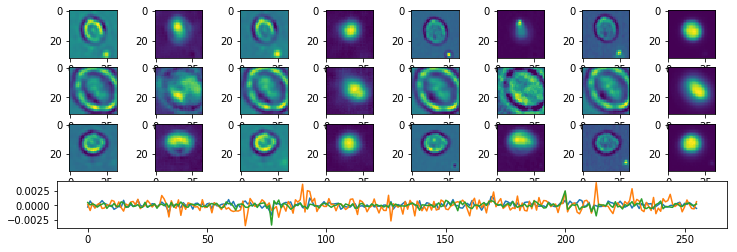

Epoch:  80 Iteration:  500 Loss:  2.8128016 2.0368848 0.7759169


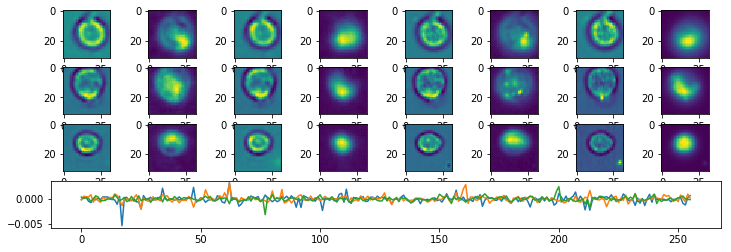

Epoch:  80 Iteration:  1000 Loss:  2.8018246 2.1344008 0.6674238


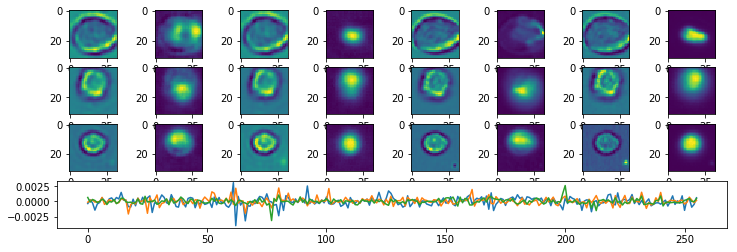

Epoch:  81 Iteration:  0 Loss:  3.9996555 2.4957864 1.503869


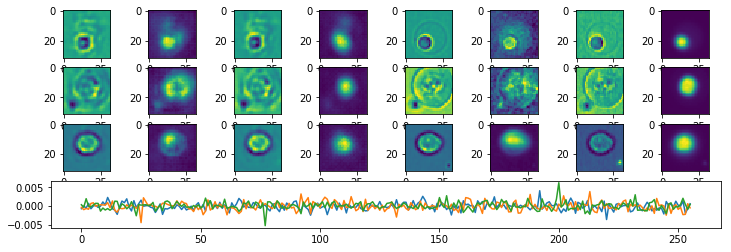

Epoch:  81 Iteration:  500 Loss:  3.2730565 2.2310627 1.0419937


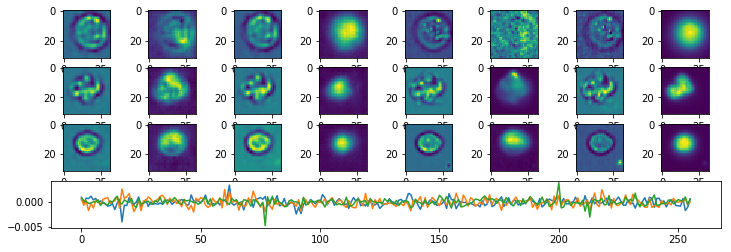

Epoch:  81 Iteration:  1000 Loss:  2.969822 2.1084857 0.86133635


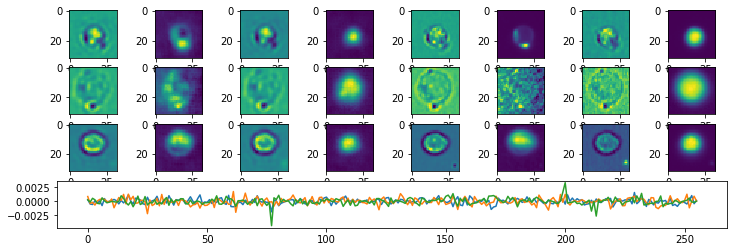

Epoch:  82 Iteration:  0 Loss:  3.520881 2.4950643 1.0258167


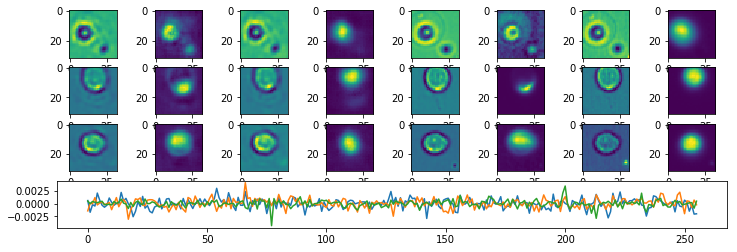

Epoch:  82 Iteration:  500 Loss:  2.9018762 2.1224253 0.7794509


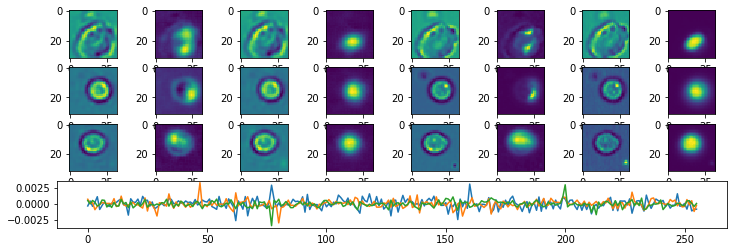

Epoch:  82 Iteration:  1000 Loss:  2.8033738 2.0956285 0.70774543


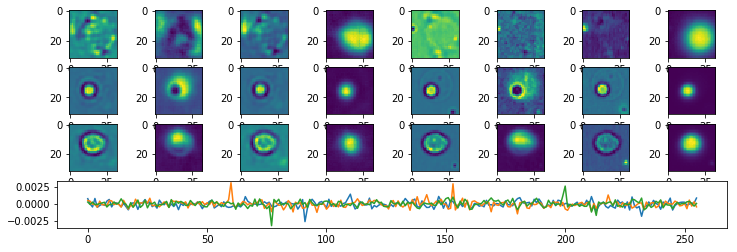

Epoch:  83 Iteration:  0 Loss:  2.7014024 1.9874985 0.71390396


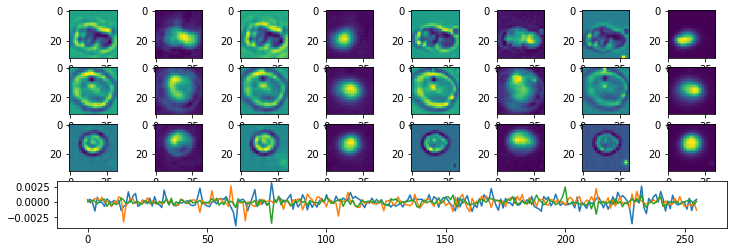

Epoch:  83 Iteration:  500 Loss:  3.0661857 2.2461913 0.8199944


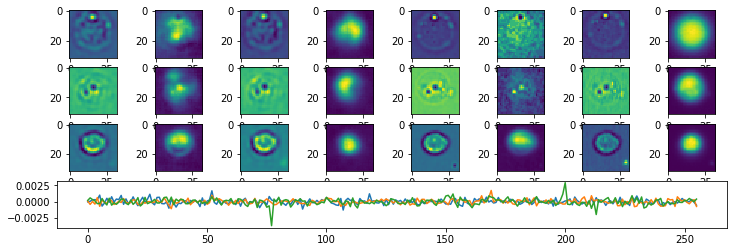

Epoch:  83 Iteration:  1000 Loss:  2.8726072 2.1627214 0.7098858


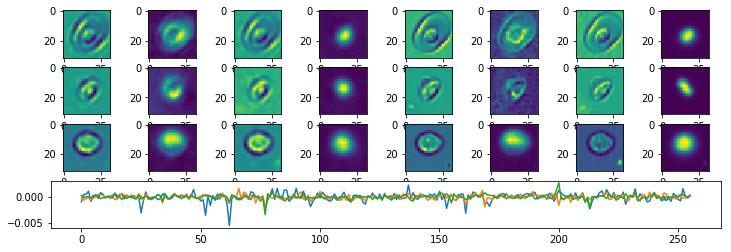

Epoch:  84 Iteration:  0 Loss:  7.0185475 4.260139 2.7584085


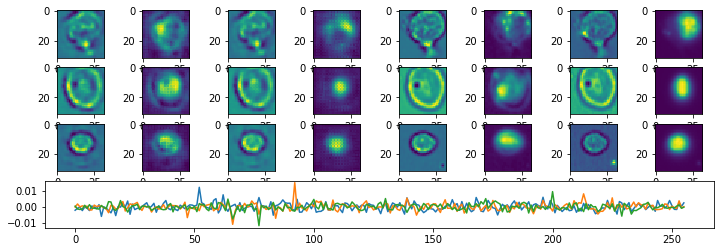

Epoch:  84 Iteration:  500 Loss:  3.5755749 2.3781521 1.1974229


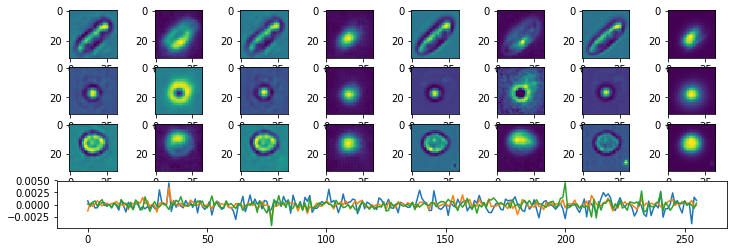

Epoch:  84 Iteration:  1000 Loss:  3.1625392 2.2397614 0.92277795


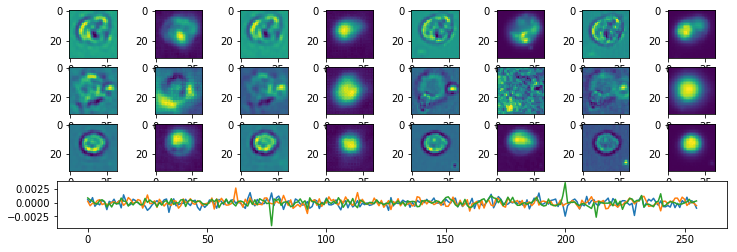

Epoch:  85 Iteration:  0 Loss:  2.848931 2.021132 0.827799


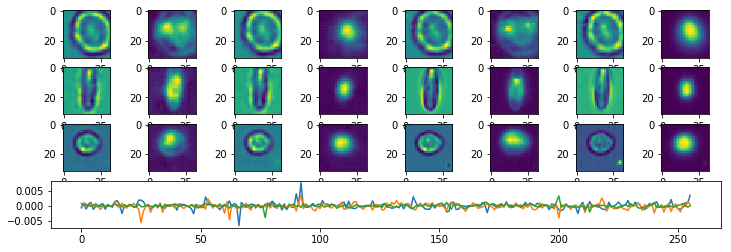

Epoch:  85 Iteration:  500 Loss:  2.8382885 2.0732126 0.7650759


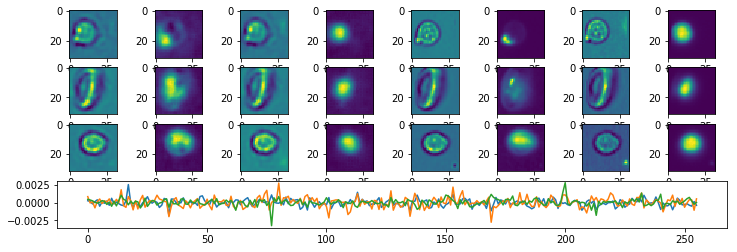

Epoch:  85 Iteration:  1000 Loss:  2.845446 2.1124148 0.7330314


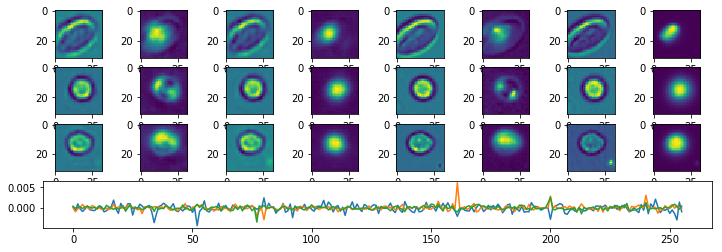

Epoch:  86 Iteration:  0 Loss:  2.6652486 1.9590752 0.70617336


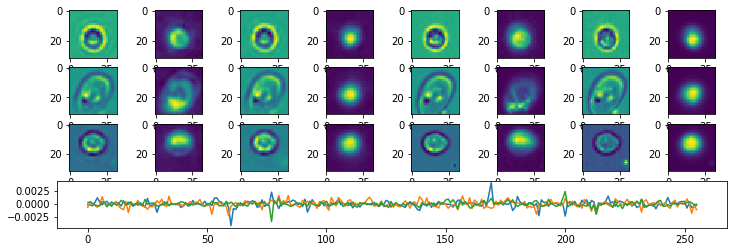

Epoch:  86 Iteration:  500 Loss:  4.0218344 2.5610476 1.4607869


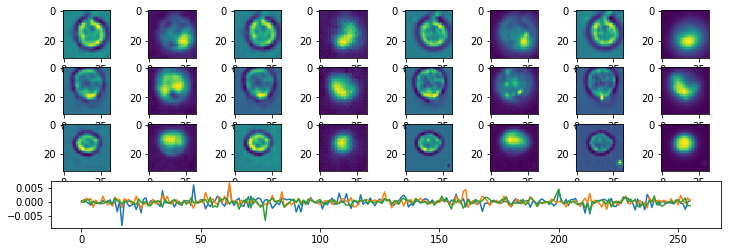

Epoch:  86 Iteration:  1000 Loss:  3.2705934 2.1973732 1.0732203


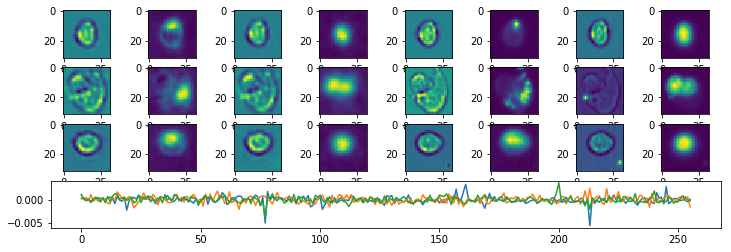

Epoch:  87 Iteration:  0 Loss:  3.1080937 2.1167417 0.991352


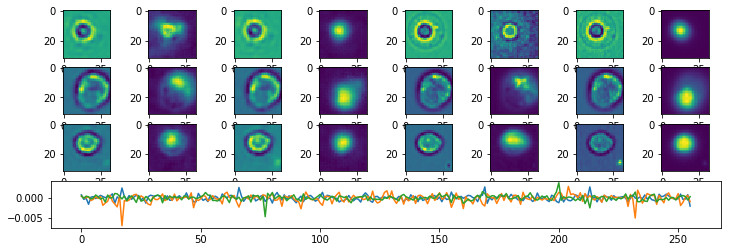

Epoch:  87 Iteration:  500 Loss:  3.069048 2.2166376 0.8524103


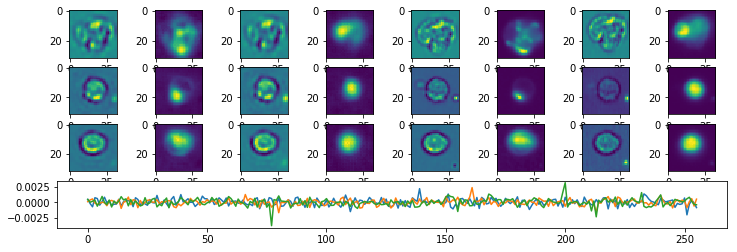

Epoch:  87 Iteration:  1000 Loss:  2.9266381 2.1565619 0.7700763


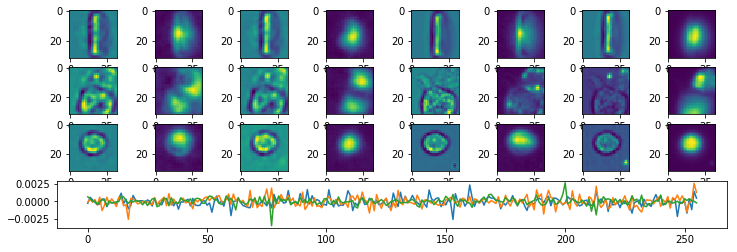

Epoch:  88 Iteration:  0 Loss:  2.726603 1.9999293 0.7266736


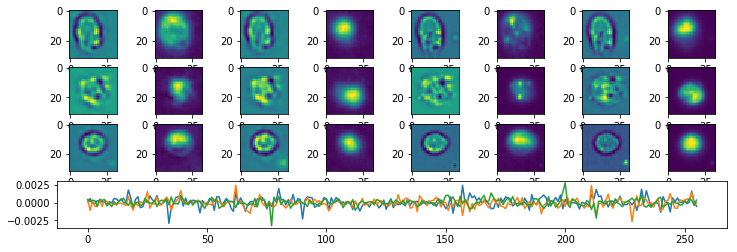

Epoch:  88 Iteration:  500 Loss:  2.7425709 2.0416794 0.70089144


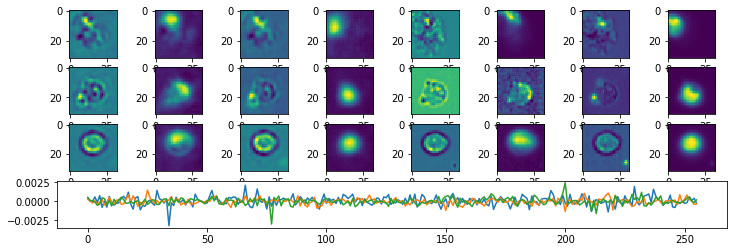

Epoch:  88 Iteration:  1000 Loss:  2.6909628 1.9953957 0.6955671


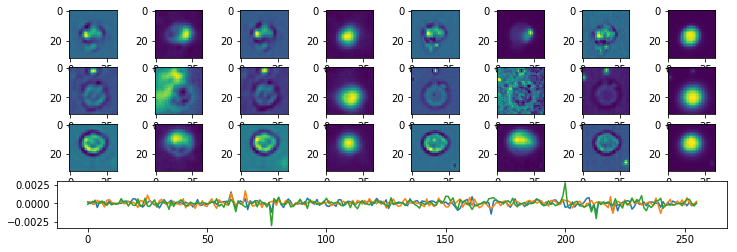

Epoch:  89 Iteration:  0 Loss:  2.579889 1.9222229 0.6576662


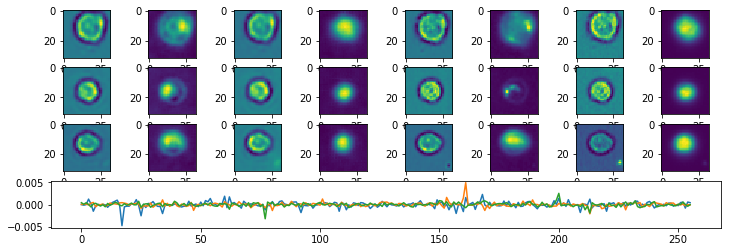

Epoch:  89 Iteration:  500 Loss:  3.674008 2.456625 1.2173828


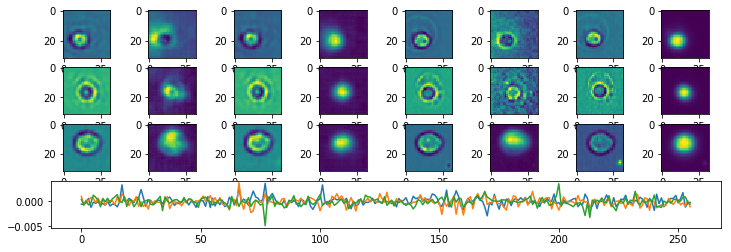

Epoch:  89 Iteration:  1000 Loss:  3.135786 2.1776762 0.95810986


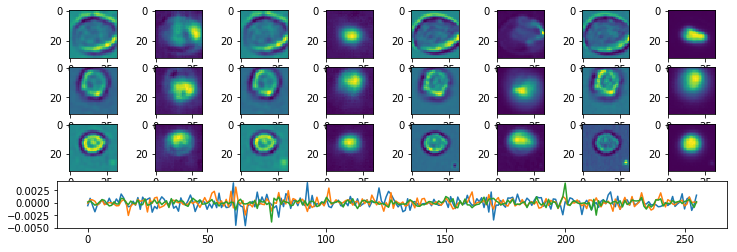

Epoch:  90 Iteration:  0 Loss:  2.872097 2.032353 0.8397442


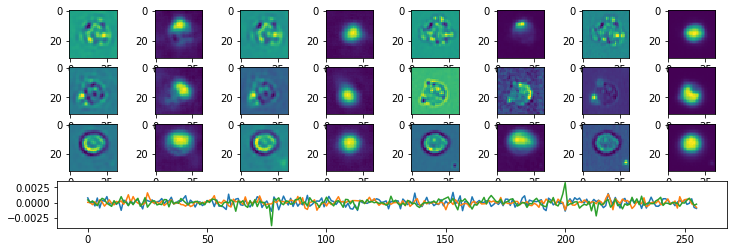

Epoch:  90 Iteration:  500 Loss:  3.7746859 2.5426188 1.232067


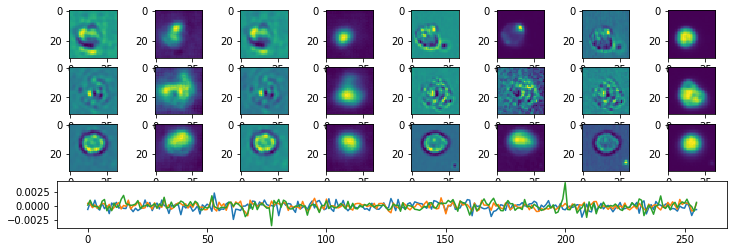

Epoch:  90 Iteration:  1000 Loss:  2.7970695 2.0575104 0.7395593


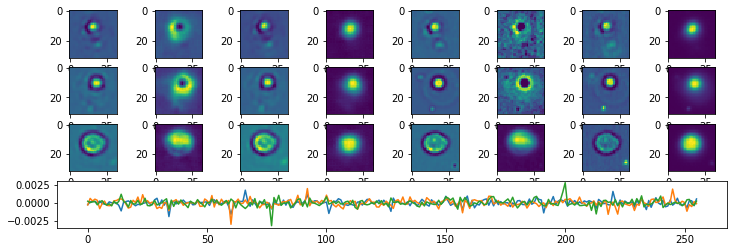

Epoch:  91 Iteration:  0 Loss:  2.6504247 1.9380205 0.7124042


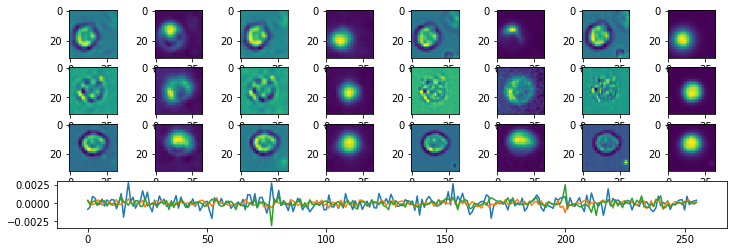

Epoch:  91 Iteration:  500 Loss:  3.265862 2.2442307 1.0216311


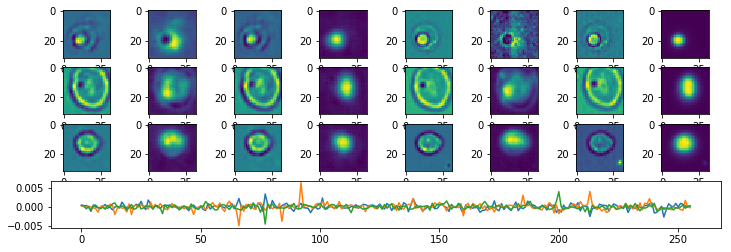

Epoch:  91 Iteration:  1000 Loss:  3.1431372 2.1754286 0.9677086


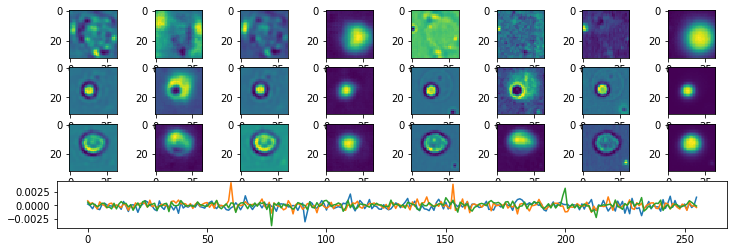

Epoch:  92 Iteration:  0 Loss:  2.6618843 1.9244905 0.737394


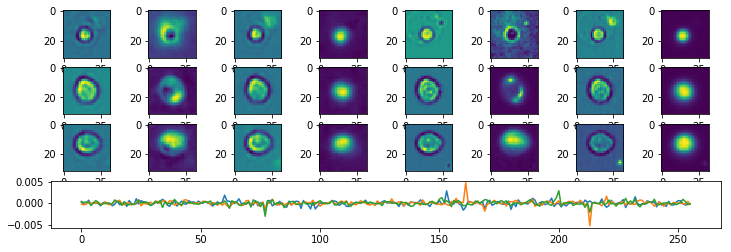

Epoch:  92 Iteration:  500 Loss:  2.7710326 2.057095 0.71393746


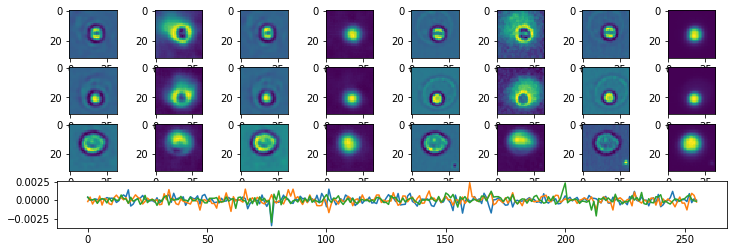

Epoch:  92 Iteration:  1000 Loss:  2.7970495 2.0839183 0.7131311


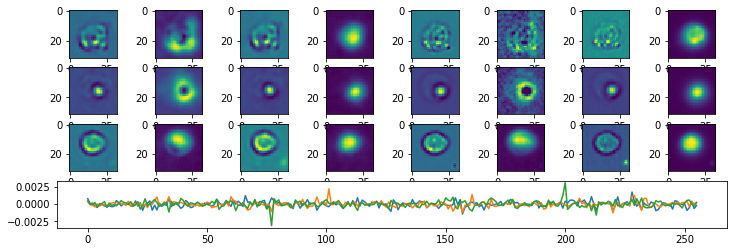

Epoch:  93 Iteration:  0 Loss:  8.844449 5.740793 3.103656


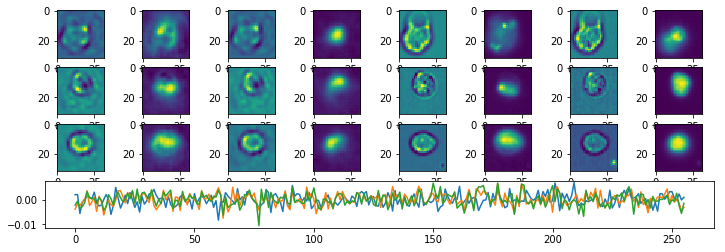

Epoch:  93 Iteration:  500 Loss:  4.124711 2.4992747 1.6254361


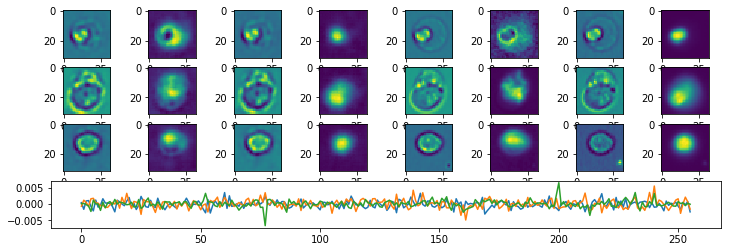

Epoch:  93 Iteration:  1000 Loss:  3.1236682 2.1203597 1.0033085


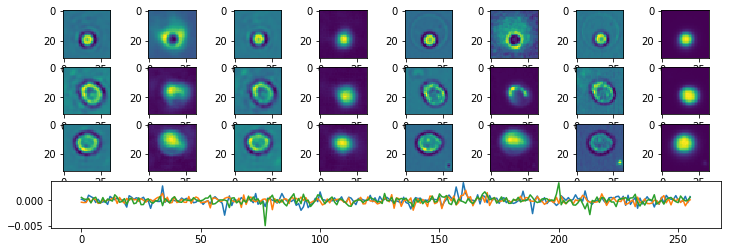

Epoch:  94 Iteration:  0 Loss:  2.8454785 1.9702137 0.87526476


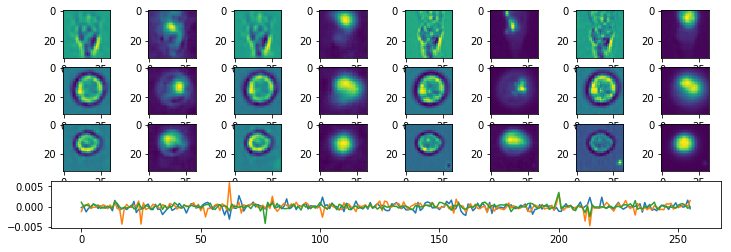

Epoch:  94 Iteration:  500 Loss:  4.49971 2.8913894 1.6083205


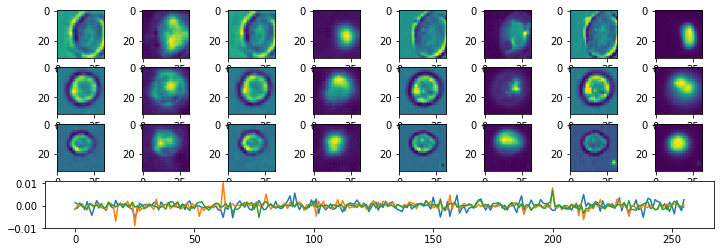

Epoch:  94 Iteration:  1000 Loss:  2.9452357 2.0702748 0.874961


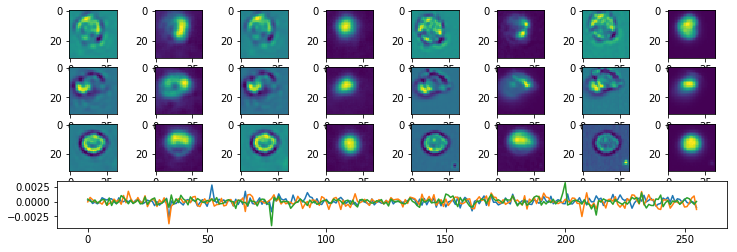

Epoch:  95 Iteration:  0 Loss:  2.7041976 1.9497437 0.75445384


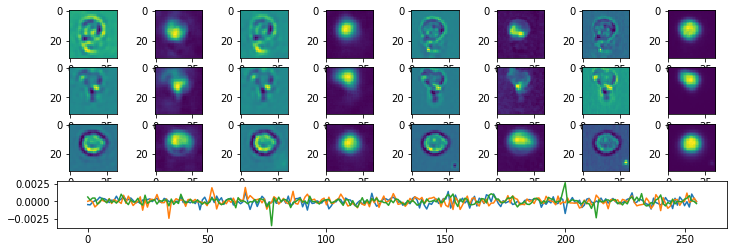

Epoch:  95 Iteration:  500 Loss:  2.7079806 1.984324 0.72365665


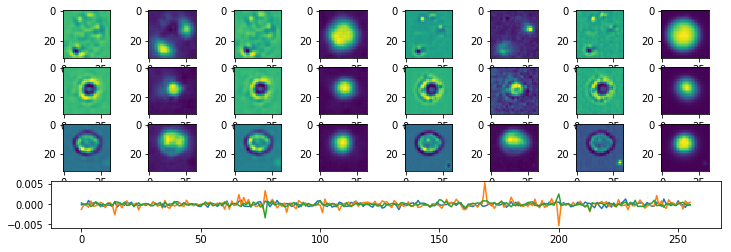

Epoch:  95 Iteration:  1000 Loss:  2.796824 2.0818162 0.7150078


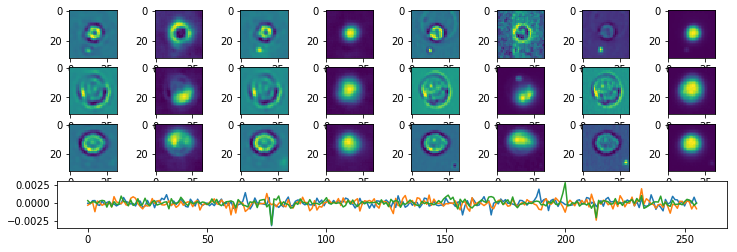

Epoch:  96 Iteration:  0 Loss:  2.480816 1.8313556 0.6494603


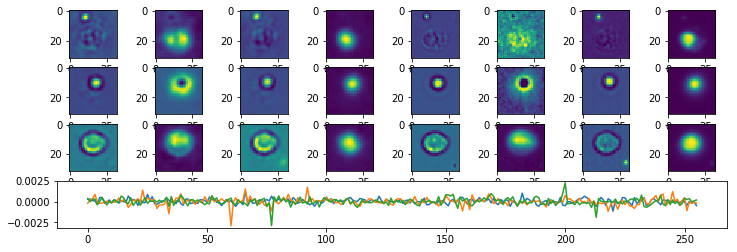

Epoch:  96 Iteration:  500 Loss:  2.7447743 2.04468 0.70009434


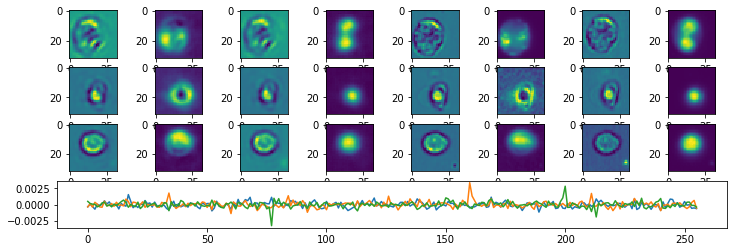

Epoch:  96 Iteration:  1000 Loss:  2.6682296 1.9790901 0.68913937


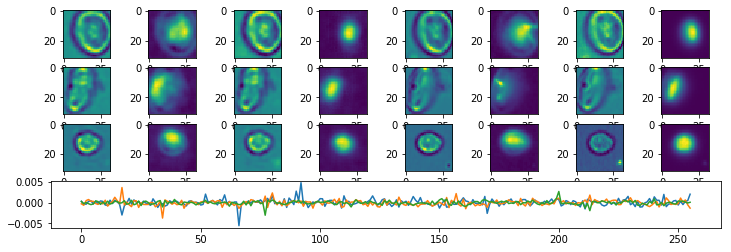

Epoch:  97 Iteration:  0 Loss:  15.177851 7.3339863 7.8438644


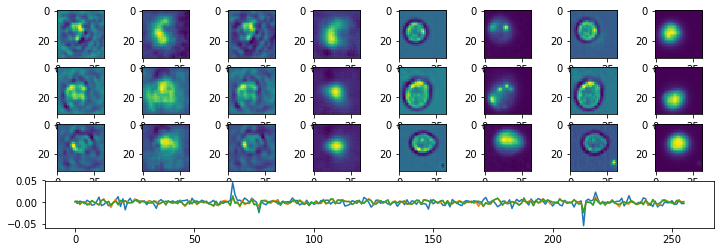

Epoch:  97 Iteration:  500 Loss:  3.6262922 2.3734982 1.2527939


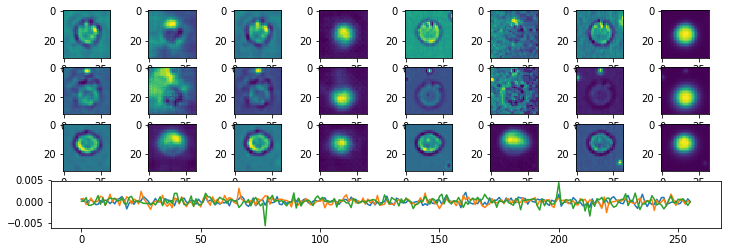

Epoch:  97 Iteration:  1000 Loss:  3.0759463 2.1577585 0.91818774


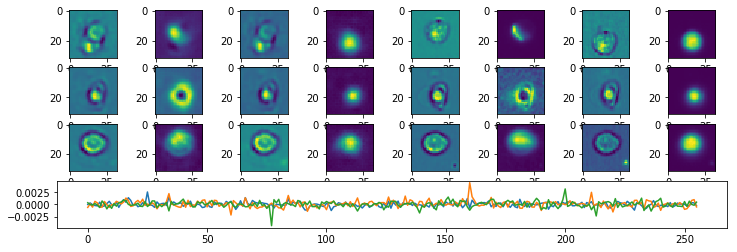

Epoch:  98 Iteration:  0 Loss:  2.8743608 2.0228658 0.85149497


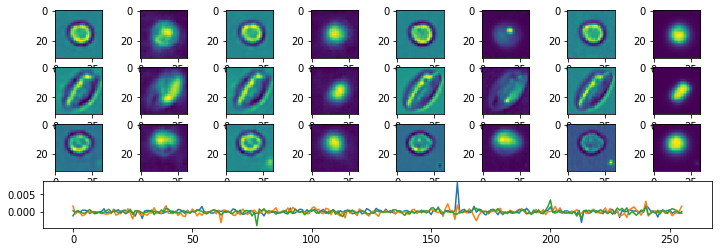

Epoch:  98 Iteration:  500 Loss:  2.8228426 2.0357099 0.7871327


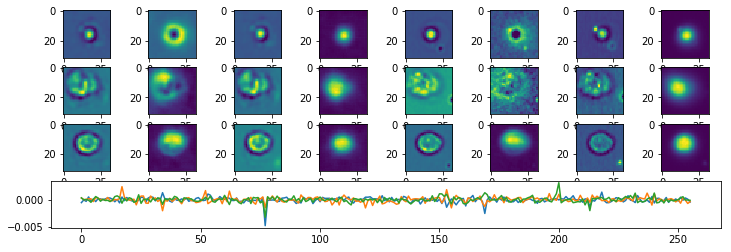

Epoch:  98 Iteration:  1000 Loss:  2.713995 1.989897 0.72409785


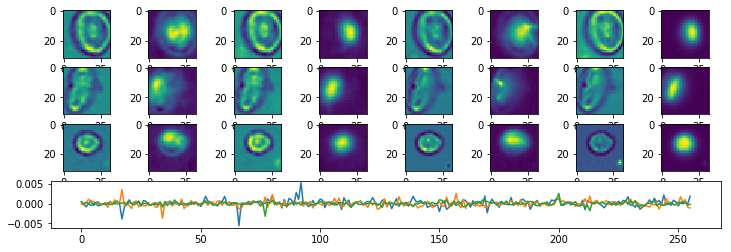

Epoch:  99 Iteration:  0 Loss:  2.5695677 1.8868778 0.6826898


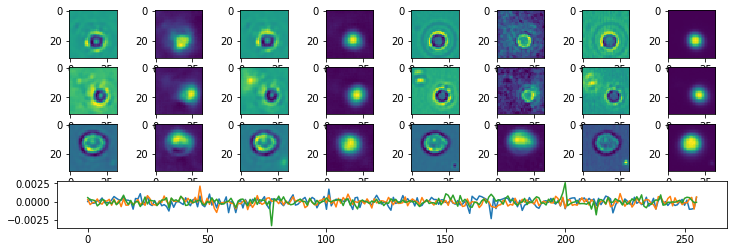

Epoch:  99 Iteration:  500 Loss:  2.6834059 1.994047 0.6893588


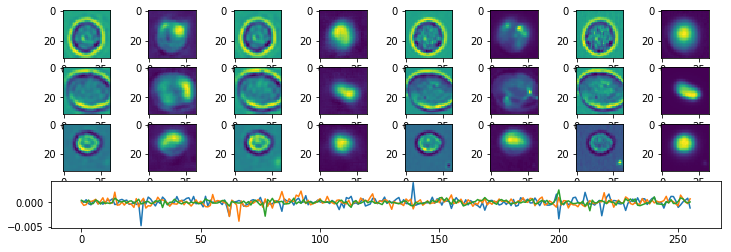

Epoch:  99 Iteration:  1000 Loss:  2.718037 2.0511253 0.66691154


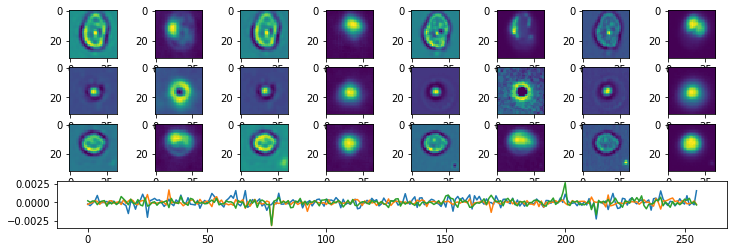

Done


In [4]:

p_mmdict = mmdict #{"Fish6_15_cjw_64.tif.mm": m3}
#             "plate04_all.mm": m4}

p_width = 32
p_height = 32
p_nchannels = 4
p_channels = [0,1,3,4]
p_nepochs = 100
p_batchsize = 128
p_learning_rate = 0.0002  #.00005
p_restore = False
p_latent_size = 256 #128 + 64
p_droprate = 0.95
p_stdev = .04

enc_sizes = [(128, 3), (256, 3), (512, 3)]  #128, 3)]
######enc_sizes = [(64, 3), (128, 3), (256,3), (512,3)] #, (64, 3), (128,3)] #, (32, 3), (64, 3)]
#enc_sizes = [(16, 5), (32, 3), (64,3), (128,3)] #, (64, 3), (128,3)] #, (32, 3), (64, 3)]
dec_sizes = list(reversed(enc_sizes))
#dec_sizes.append((p_nchannels,7))

params = dict()

params['width'] = p_width
params['height'] = p_height
params['nchannels'] = p_nchannels
params['channels'] = p_channels
params['nepochs'] = p_nepochs
params['batchsize'] = p_batchsize
params['learning_rate'] = p_learning_rate
params['restore'] = p_restore
params['latent_size'] = p_latent_size
params['droprate'] = p_droprate
params['stdev'] = p_stdev
params['denoise'] = None
params['slam'] = 0.05
params['enc_sizes'] = enc_sizes
params['dec_sizes'] = dec_sizes

#cpdir = "/media/cjw/Data/cyto/Checkpoints/2018-06-07-256"
cpdir = "/v/Data/cyto/Checkpoints/2018-06-11-256"

if not os.path.exists(cpdir):
    os.makedirs(cpdir)
autoencoder_train.train(p_mmdict, p_df, params, 500, cpdir)

In [ ]:
x = 4
x